<a href="https://colab.research.google.com/github/chang-heekim/Oxford-Pet-Dataset/blob/main/Oxford_Pet_Dataset_Semantic_Segmenatiation_2_Class_Pytorch.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Load Necessary Library

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import os
from glob import glob
from datetime import datetime
import cv2

from torch.utils.data import Dataset
from torchvision.datasets import ImageFolder
from PIL import Image
import torch

from torchvision import transforms
from torch.utils.data import random_split
from torch.utils.data import DataLoader
from torch import nn, optim
from torchsummary import summary
import torch.nn.functional as F

# Setting device &  Data Preprocessing

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device 

'cuda'

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/dataset/oxford_pet/annotations/list.txt', skiprows=6, delimiter=' ', header=None)
df.columns = ['file_name', 'id', 'species', 'breed']
df.head()

,file_name,id,species,breed
0,Abyssinian_100,1,1,1
1,Abyssinian_101,1,1,1
2,Abyssinian_102,1,1,1
3,Abyssinian_103,1,1,1
4,Abyssinian_104,1,1,1


In [ ]:
image_dir = '/content/drive/MyDrive/dataset/oxford_pet/images/'
seg_dir = '/content/drive/MyDrive/dataset/oxford_pet/annotations/trimaps/'

In [ ]:
image_files = glob(image_dir + '*.jpg')
seg_files = glob(seg_dir + '*.png')
len(image_files), len(seg_files)

(7378, 7390)

In [ ]:
seg_path = []
i = 0
for idx, img_file in enumerate(image_files):
    seg = img_file.replace(image_dir, seg_dir).replace('jpg', 'png')
    if seg in seg_files:
        seg_path.append(seg)
    else:
        image_files.pop(idx - i)
        i += 1

len(image_files), len(seg_path)

(7378, 7378)

In [ ]:
image_files[:10], seg_path[:10]

(['/content/drive/MyDrive/dataset/oxford_pet/images/shiba_inu_12.jpg',
  '/content/drive/MyDrive/dataset/oxford_pet/images/wheaten_terrier_137.jpg',
  '/content/drive/MyDrive/dataset/oxford_pet/images/Bengal_88.jpg',
  '/content/drive/MyDrive/dataset/oxford_pet/images/keeshond_170.jpg',
  '/content/drive/MyDrive/dataset/oxford_pet/images/newfoundland_107.jpg',
  '/content/drive/MyDrive/dataset/oxford_pet/images/japanese_chin_106.jpg',
  '/content/drive/MyDrive/dataset/oxford_pet/images/Birman_49.jpg',
  '/content/drive/MyDrive/dataset/oxford_pet/images/Sphynx_90.jpg',
  '/content/drive/MyDrive/dataset/oxford_pet/images/Persian_126.jpg',
  '/content/drive/MyDrive/dataset/oxford_pet/images/japanese_chin_105.jpg'],
 ['/content/drive/MyDrive/dataset/oxford_pet/annotations/trimaps/shiba_inu_12.png',
  '/content/drive/MyDrive/dataset/oxford_pet/annotations/trimaps/wheaten_terrier_137.png',
  '/content/drive/MyDrive/dataset/oxford_pet/annotations/trimaps/Bengal_88.png',
  '/content/drive/MyDr

# Define Dataset & Visualization

In [ ]:
class Oxford_Segmentation_Dataset(Dataset):
    def __init__(self, img_dir, seg_path, transform=None, target_transform=None):
        self.img_dir = img_dir
        self.transform = transform
        self.target_transform = target_transform
        self.seg_path = seg_path
        
    def __len__(self):
        return len(self.img_dir)

    def __getitem__(self, idx):
        img_path = self.img_dir[idx]
        image = Image.open(img_path)
        seg_path = self.seg_path[idx]
        seg = np.array(Image.open(seg_path))
        seg[seg != 1] = 0

        if self.transform:
            image = self.transform(image)
        if self.target_transform:
            seg = self.target_transform(seg)
            seg = np.array(seg)
            seg = torch.unsqueeze(torch.tensor(seg.astype('float32')), 0)
    
        return image, seg

In [ ]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor()
])

target_transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((224, 224)),
])

dataset = Oxford_Segmentation_Dataset(
    img_dir=image_files, 
    seg_path=seg_path, 
    transform=transform, 
    target_transform=target_transform
)

train_size = int(len(dataset) * 0.9)
val_size = len(dataset) - train_size

train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

In [ ]:
train_batch_size = 32
val_batch_size = 16

train_loader = DataLoader(train_dataset, batch_size=train_batch_size, shuffle=True, num_workers=2)
val_loader = DataLoader(val_dataset, batch_size=val_batch_size, shuffle=False, num_workers=2)

In [ ]:
for idx, sample_batch in enumerate(train_loader):
    print(sample_batch[0].shape)
    print(sample_batch[1].shape)
    print(sample_batch[0].dtype)
    print(sample_batch[1].dtype)
    print()
    break

torch.Size([32, 3, 224, 224])
torch.Size([32, 1, 224, 224])
torch.float32
torch.float32



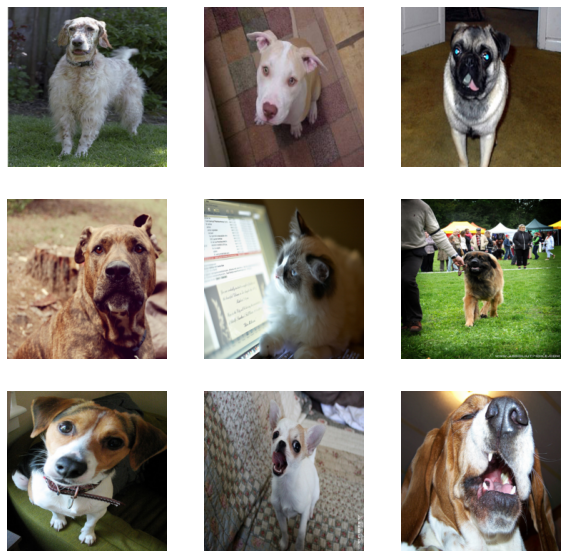

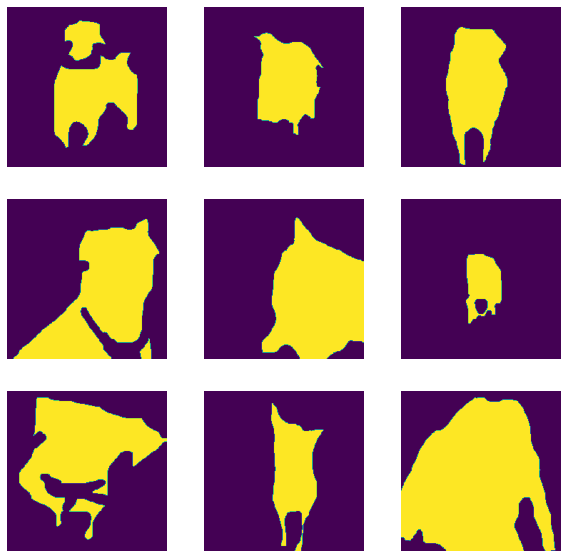

In [ ]:
sample = next(iter(val_loader))
plt.figure(figsize=(10,10))
for i in range(9):
    plt.subplot(3,3,i+1)
    plt.imshow(torch.permute(sample[0][i], (1, 2, 0)))
    plt.axis('off')
plt.show()

plt.figure(figsize=(10,10))
for i in range(9):
    plt.subplot(3,3,i+1)
    plt.imshow(torch.squeeze(sample[1][i], 0))
    plt.axis('off')
plt.show()

# Define UNet & Optimizer & Dice Loss function & IOU

In [ ]:
class DConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()

        self.dconv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(),
            nn.Conv2d(out_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(),
        )

    def forward(self, x):
        return self.dconv(x)


class UNet(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()

        self.max_pool = nn.MaxPool2d(2)

        self.enc1 = DConv(in_channels, 64)
        self.enc2 = DConv(64, 128)
        self.enc3 = DConv(128, 256)
        self.enc4 = DConv(256, 512)
        
        self.enc5 = nn.Conv2d(512, 1024, 3, 1, 1)
        self.dec5 = nn.Conv2d(1024, 512, 3, 1, 1)

        self.up_pool_4 = nn.ConvTranspose2d(512, 512, 2, 2, 0)
        self.dec4 = DConv(1024, 512)

        self.up_pool_3 = nn.ConvTranspose2d(512, 256, 2, 2, 0)
        self.dec3 = DConv(512, 256)

        self.up_pool_2 = nn.ConvTranspose2d(256, 128, 2, 2, 0)
        self.dec2 = DConv(256, 128)

        self.up_pool_1 = nn.ConvTranspose2d(128, 64, 2, 2, 0)
        self.dec1 = DConv(128, 64)

        self.conv = nn.Conv2d(64, out_channels, 1, 1, 0)
        
    def forward(self, x):
        enc1 = self.enc1(x)
        pool1 = self.max_pool(enc1)
        enc2 = self.enc2(pool1)
        pool2 = self.max_pool(enc2)
        enc3 = self.enc3(pool2)
        pool3 = self.max_pool(enc3)
        enc4 = self.enc4(pool3)
        pool4 = self.max_pool(enc4)
        
        enc5 = self.enc5(pool4)
        dec5 = self.dec5(enc5)

        up_pool4 = self.up_pool_4(dec5)
        cat4 = torch.cat((up_pool4, enc4), dim=1)
        dec4 = self.dec4(cat4)

        up_pool3 = self.up_pool_3(dec4)
        cat3 = torch.cat((up_pool3, enc3), dim=1)
        dec3 = self.dec3(cat3)

        up_pool2 = self.up_pool_2(dec3)
        cat2 = torch.cat((up_pool2, enc2), dim=1)
        dec2 = self.dec2(cat2)

        up_pool1 = self.up_pool_1(dec2)
        cat1 = torch.cat((up_pool1, enc1), dim=1)
        dec1 = self.dec1(cat1)

        out = self.conv(dec1)
        out = torch.sigmoid(out)

        return out

In [ ]:
def iou(preds, targets):
    smooth = 1e-5

    preds = preds.detach().cpu().numpy()
    targets = targets.detach().cpu().numpy()

    intersection = np.sum(np.logical_and(targets, preds))
    union = np.sum(np.logical_or(targets, preds))
    iou_score = (torch.tensor(intersection) + smooth)  / (torch.tensor(union) + smooth)

    return iou_score

def dice_coef(preds, targets):
    smooth = 1e-5

    preds = preds.detach().cpu().numpy()
    targets = targets.detach().cpu().numpy()

    intersection = np.sum(np.logical_and(targets, preds))
    union = np.sum(np.logical_or(targets, targets)) + np.sum(np.logical_or(preds, preds))
    dice = (2 * torch.tensor(intersection) + smooth) / (torch.tensor(union) + smooth )
    return dice
    

def dice_loss(preds, targets):
    return 1 - dice_coef(targets, preds)

def bce_dice_loss(preds, targets):
    loss_fn = nn.BCELoss()
    loss = 1. * loss_fn(preds, targets) + 1. * dice_loss(preds, targets)

    return loss

In [ ]:
lr = 1e-2
epochs = 30

model = UNet(3, 1).to(device)
model_name = type(model).__name__
summary(model, (3, 224, 224))

loss_fn = bce_dice_loss

optimizer = optim.Adam(model.parameters(), lr=lr)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 224, 224]           1,728
       BatchNorm2d-2         [-1, 64, 224, 224]             128
              ReLU-3         [-1, 64, 224, 224]               0
            Conv2d-4         [-1, 64, 224, 224]          36,864
       BatchNorm2d-5         [-1, 64, 224, 224]             128
              ReLU-6         [-1, 64, 224, 224]               0
             DConv-7         [-1, 64, 224, 224]               0
         MaxPool2d-8         [-1, 64, 112, 112]               0
            Conv2d-9        [-1, 128, 112, 112]          73,728
      BatchNorm2d-10        [-1, 128, 112, 112]             256
             ReLU-11        [-1, 128, 112, 112]               0
           Conv2d-12        [-1, 128, 112, 112]         147,456
      BatchNorm2d-13        [-1, 128, 112, 112]             256
             ReLU-14        [-1, 128, 1

# Define Training & Validation Function

In [ ]:
def train(epoch, model, train_loader, loss_fn, optimizer):
    print(f' Epoch: [{epoch}/{epochs}] - Train')
    model.train()
    current_loss = 0.0
    current_iou = 0.0
    for batch_idx, (images, seg_map) in enumerate(train_loader):
        images, seg_map = images.to(device), seg_map.to(device)

        outputs = model(images)

        loss = loss_fn(outputs, seg_map)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        outputs = (outputs >= 0.5).int()

        current_loss += loss.item()
        current_iou += iou(outputs, seg_map)

        if (batch_idx + 1) % 50 == 0:
            train_loss = current_loss / 50
            train_iou = current_iou / 50
            print(f'Current Step: {batch_idx + 1} \tTrain Loss: {train_loss}, Train Iou: {train_iou}')

            plt.figure(figsize=(15, 15))
            plt.subplot(131)
            plt.imshow(torch.permute(images[0], (1, 2, 0)).detach().cpu().numpy())
            plt.title('Image')
            plt.axis('off')
            plt.subplot(132)
            plt.imshow(torch.squeeze(torch.squeeze(seg_map[0], 0), 0).detach().cpu().numpy())
            plt.title('Seg Map')
            plt.axis('off')
            plt.subplot(133)
            plt.imshow(torch.squeeze(torch.squeeze(outputs[0], 0), 0).detach().cpu().numpy())
            plt.title('Predict')
            plt.axis('off')
            plt.show()

            current_loss = 0.0
            current_iou = 0.0

    return train_loss, train_iou

def validation(epoch, model, val_loader, loss_fn):
    print(f' Epoch: [{epoch}/{epochs}] - Validation')
    with torch.no_grad():
        model.eval()
        val_loss = 0.0
        val_iou = 0.0
        for val_idx, (val_images, val_seg_map) in enumerate(val_loader):

            val_images, val_seg_map = val_images.to(device), val_seg_map.to(device)
            val_outputs = model(val_images)

            val_loss += loss_fn(val_outputs, val_seg_map)

            val_outputs = (val_outputs >= 0.5).int()
            
            val_iou += iou(val_outputs, val_seg_map)

        val_epoch_loss = val_loss / len(val_loader)
        val_epoch_iou = val_iou / len(val_loader)

    print(f'Validation step: Val Loss: {val_epoch_loss}, Val Iou: {val_epoch_iou}')

    plt.figure(figsize=(15, 15))
    plt.subplot(131)
    plt.imshow(torch.permute(val_images[0], (1, 2, 0)).detach().cpu().numpy())
    plt.title('Image')
    plt.axis('off')
    plt.subplot(132)
    plt.imshow(torch.squeeze(torch.squeeze(val_seg_map[0], 0), 0).detach().cpu().numpy())
    plt.title('Seg Map')
    plt.axis('off')
    plt.subplot(133)
    plt.imshow(torch.squeeze(torch.squeeze(val_outputs[0], 0), 0).detach().cpu().numpy())
    plt.title('Predict')
    plt.axis('off')
    plt.show()

    return val_epoch_loss, val_epoch_iou

# Training

 Epoch: [1/30] - Train
Current Step: 50 	Train Loss: 1.0639234292507171, Train Iou: 0.2056741714477539


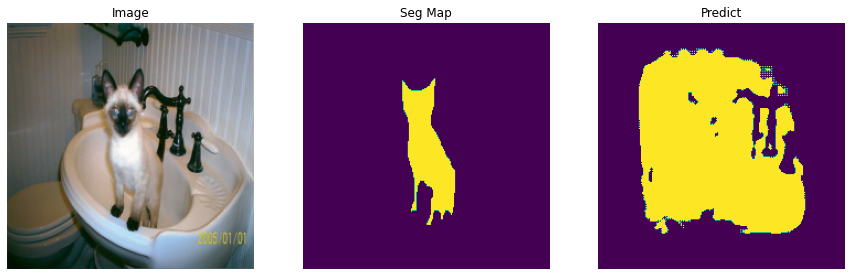

Current Step: 100 	Train Loss: 0.9807499766349792, Train Iou: 0.46357908844947815


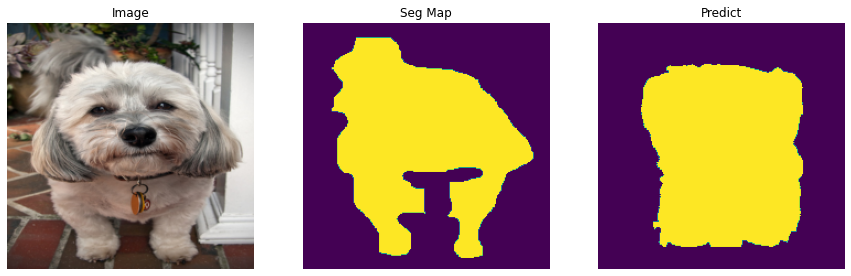

Current Step: 150 	Train Loss: 0.9632872879505158, Train Iou: 0.474440336227417


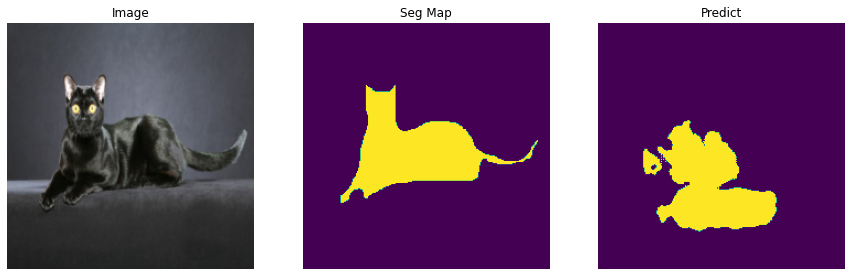

Current Step: 200 	Train Loss: 0.9484166502952576, Train Iou: 0.4952135384082794


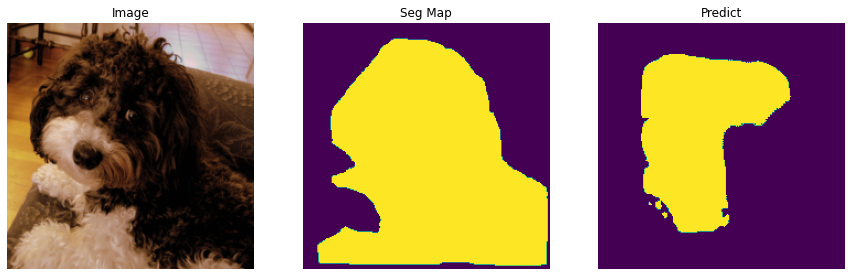

 Epoch: [1/30] - Validation
Validation step: Val Loss: 1.0247336626052856, Val Iou: 0.24328207969665527


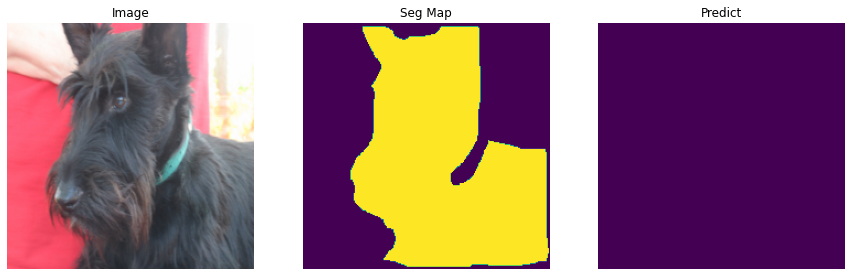

 Epoch: [2/30] - Train
Current Step: 50 	Train Loss: 0.9405626451969147, Train Iou: 0.5082923769950867


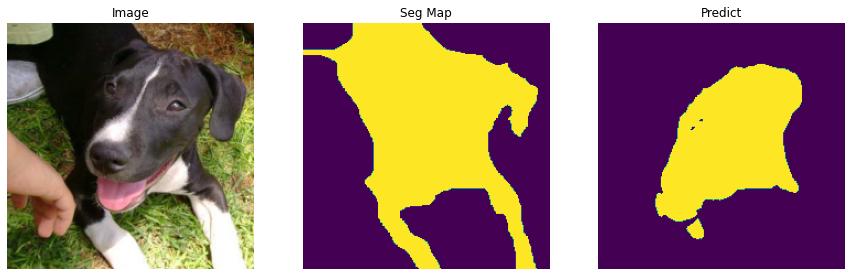

Current Step: 100 	Train Loss: 0.924657142162323, Train Iou: 0.5295969247817993


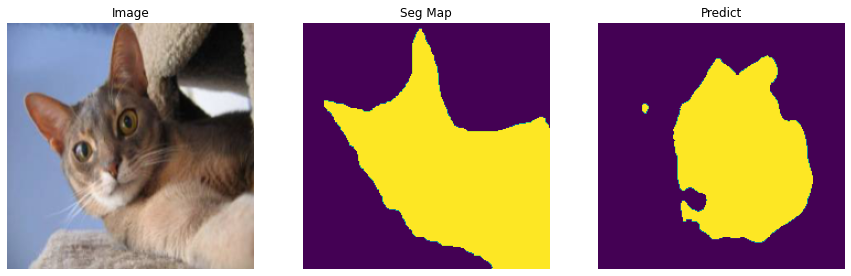

Current Step: 150 	Train Loss: 0.9267421221733093, Train Iou: 0.5190332531929016


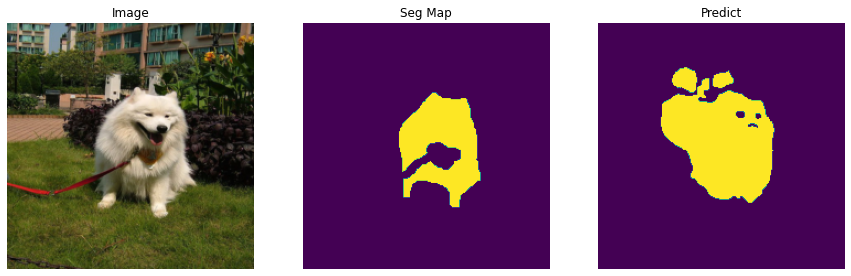

Current Step: 200 	Train Loss: 0.9132206976413727, Train Iou: 0.5441401600837708


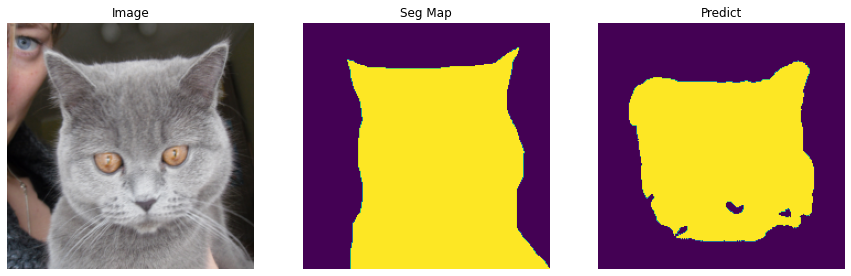

 Epoch: [2/30] - Validation
Validation step: Val Loss: 0.9308084845542908, Val Iou: 0.548134446144104


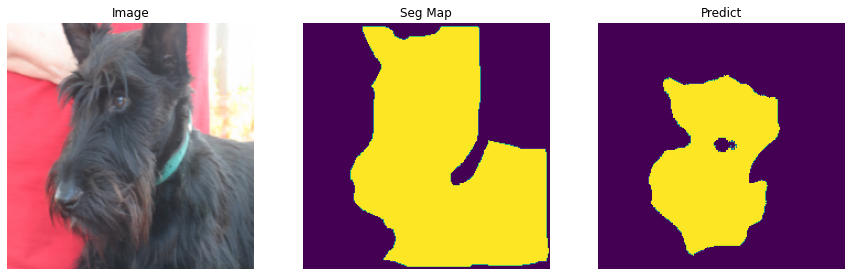

 Epoch: [3/30] - Train
Current Step: 50 	Train Loss: 0.9108942985534668, Train Iou: 0.5479415655136108


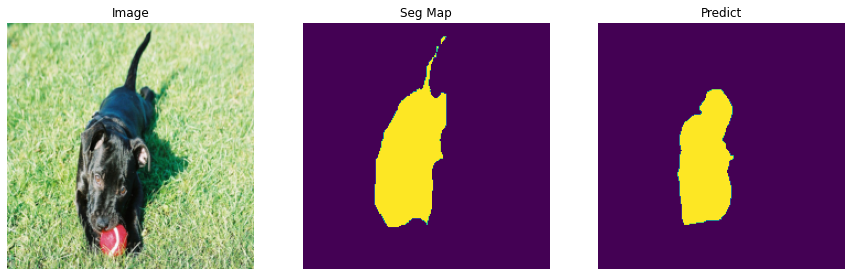

Current Step: 100 	Train Loss: 0.896095484495163, Train Iou: 0.5668708086013794


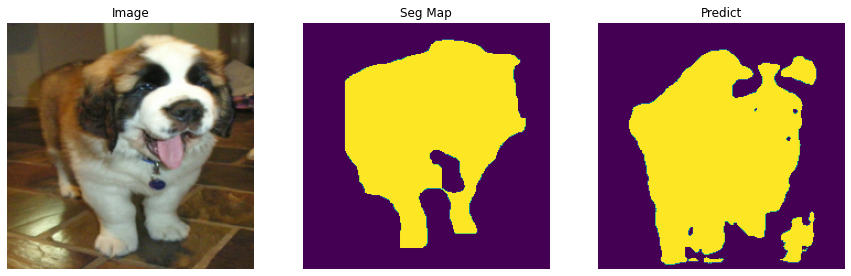

Current Step: 150 	Train Loss: 0.8917749214172364, Train Iou: 0.5664991736412048


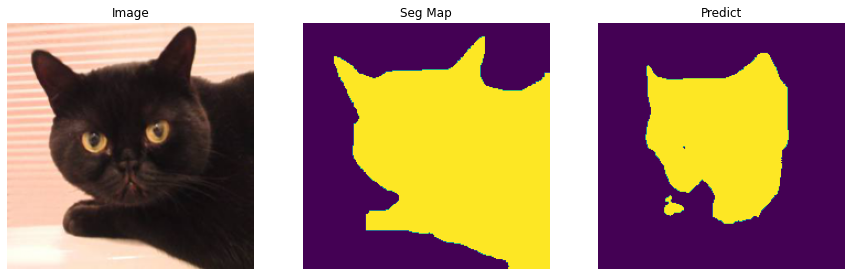

Current Step: 200 	Train Loss: 0.8810605680942536, Train Iou: 0.5814851522445679


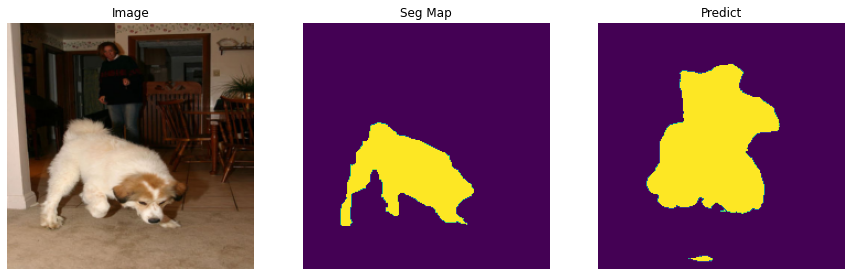

 Epoch: [3/30] - Validation
Validation step: Val Loss: 0.8820478320121765, Val Iou: 0.5702624917030334


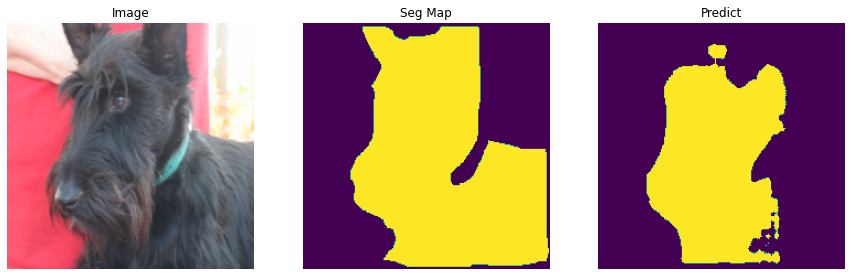

 Epoch: [4/30] - Train
Current Step: 50 	Train Loss: 0.8734681499004364, Train Iou: 0.5908212065696716


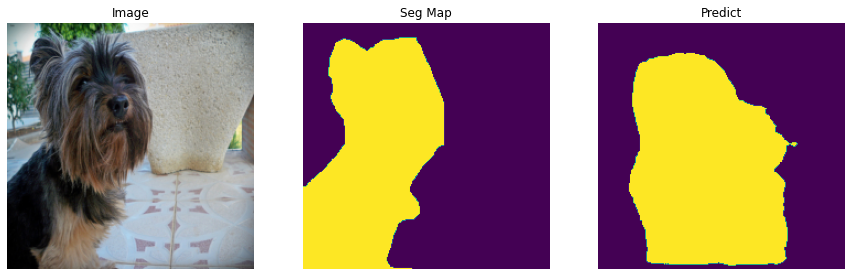

Current Step: 100 	Train Loss: 0.8726707291603089, Train Iou: 0.5960405468940735


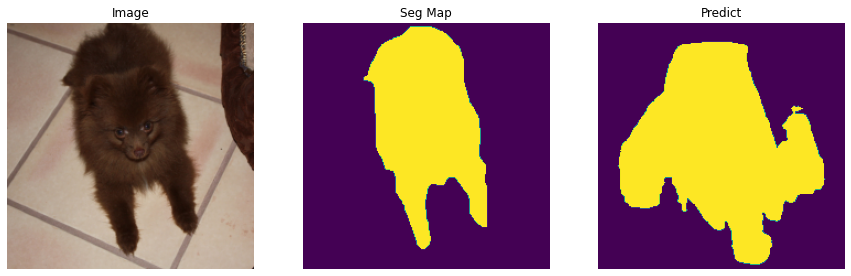

Current Step: 150 	Train Loss: 0.8516199827194214, Train Iou: 0.6167928576469421


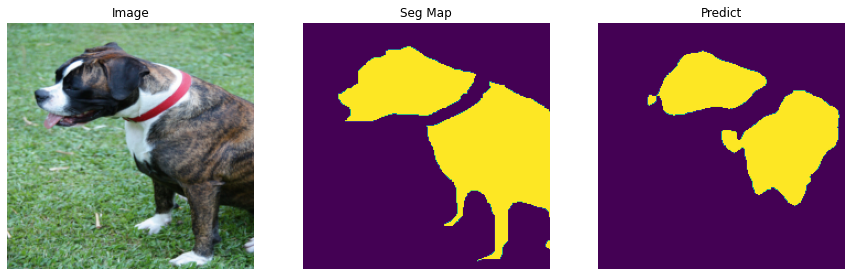

Current Step: 200 	Train Loss: 0.8496439957618713, Train Iou: 0.6242076754570007


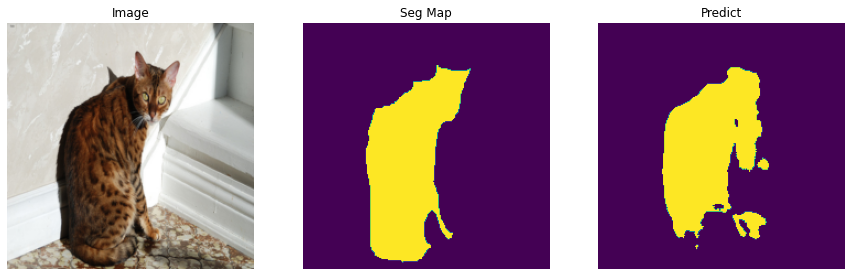

 Epoch: [4/30] - Validation
Validation step: Val Loss: 0.8812299370765686, Val Iou: 0.5178087949752808


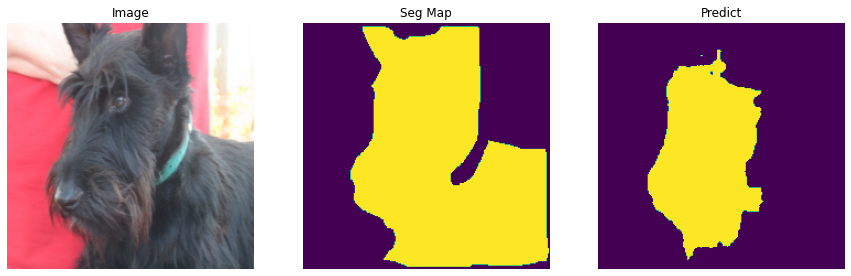

 Epoch: [5/30] - Train
Current Step: 50 	Train Loss: 0.8460955083370209, Train Iou: 0.6314139366149902


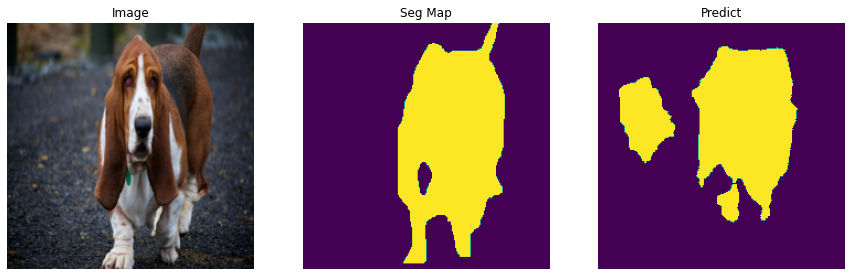

Current Step: 100 	Train Loss: 0.8367807245254517, Train Iou: 0.6405304074287415


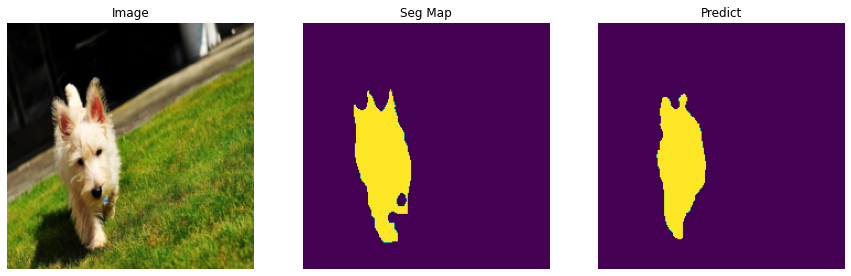

Current Step: 150 	Train Loss: 0.8241678977012634, Train Iou: 0.6503533124923706


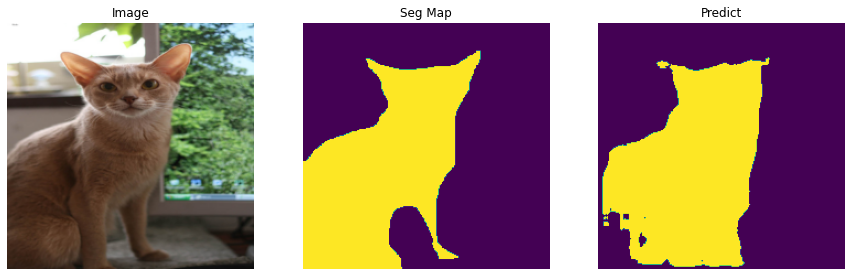

Current Step: 200 	Train Loss: 0.8149299156665802, Train Iou: 0.6656058430671692


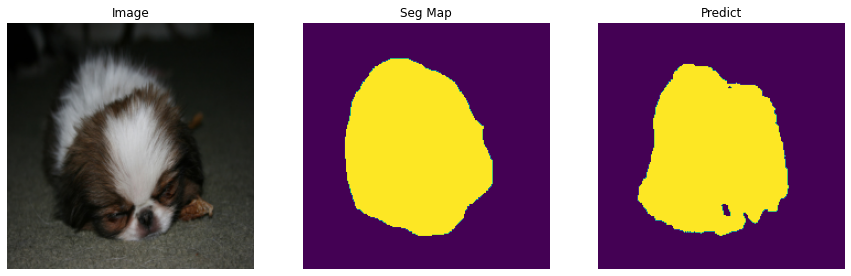

 Epoch: [5/30] - Validation
Validation step: Val Loss: 0.8850815892219543, Val Iou: 0.5274900794029236


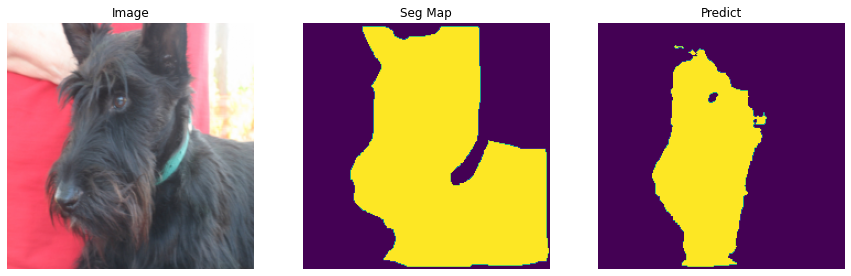

 Epoch: [6/30] - Train
Current Step: 50 	Train Loss: 0.8068274748325348, Train Iou: 0.67913818359375


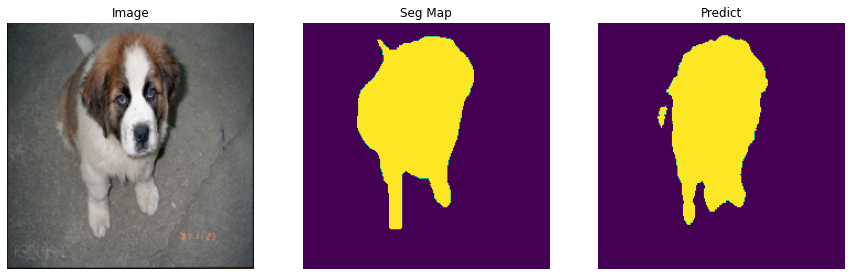

Current Step: 100 	Train Loss: 0.8066353023052215, Train Iou: 0.6707721948623657


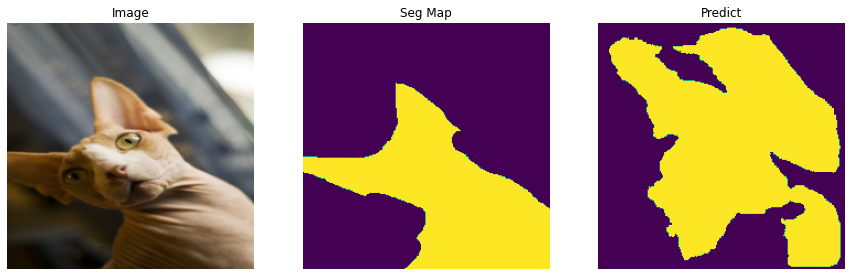

Current Step: 150 	Train Loss: 0.7841793024539947, Train Iou: 0.6987686157226562


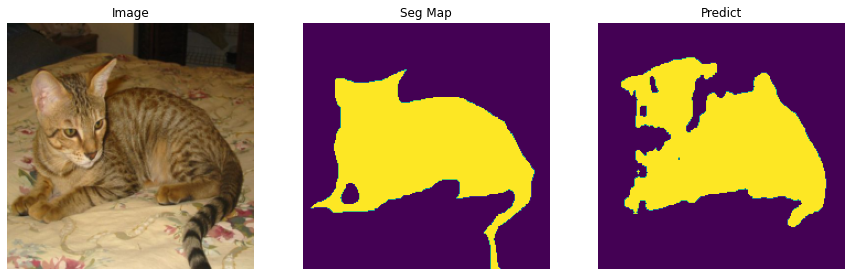

Current Step: 200 	Train Loss: 0.7821038722991943, Train Iou: 0.704197108745575


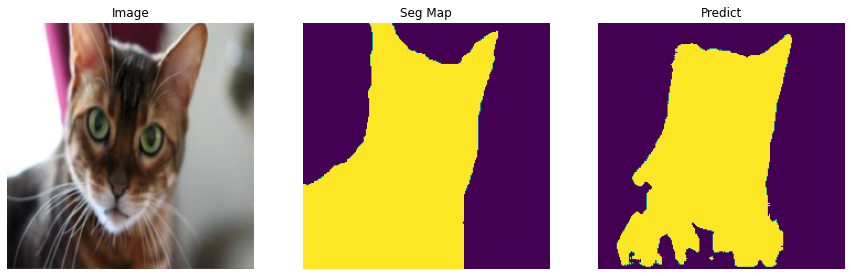

 Epoch: [6/30] - Validation
Validation step: Val Loss: 0.7835133671760559, Val Iou: 0.6854075789451599


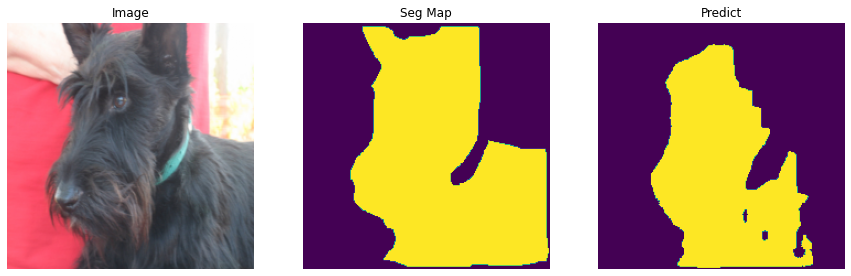

 Epoch: [7/30] - Train
Current Step: 50 	Train Loss: 0.7838791596889496, Train Iou: 0.6989443898200989


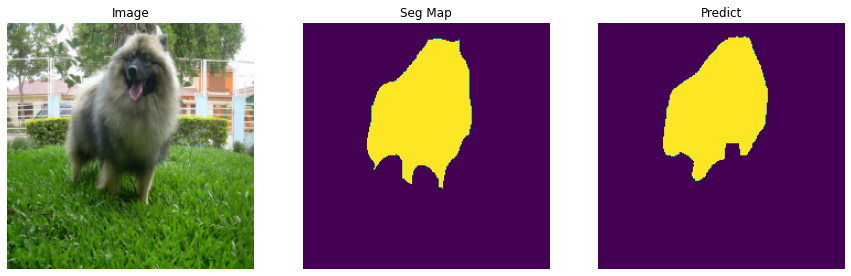

Current Step: 100 	Train Loss: 0.775576947927475, Train Iou: 0.7130181193351746


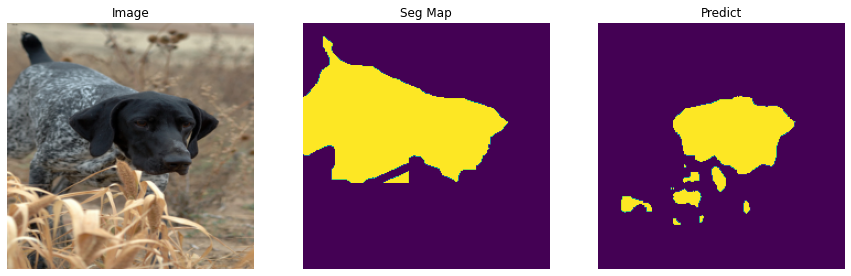

Current Step: 150 	Train Loss: 0.7709491896629334, Train Iou: 0.7158774733543396


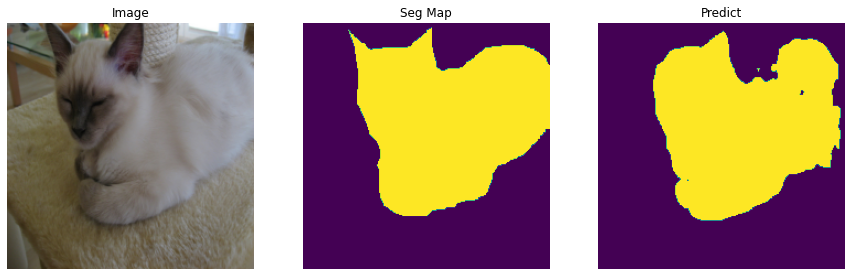

Current Step: 200 	Train Loss: 0.7721418929100037, Train Iou: 0.7173730731010437


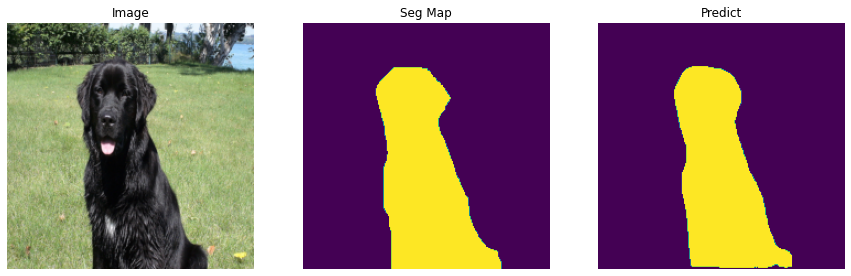

 Epoch: [7/30] - Validation
Validation step: Val Loss: 0.7662012577056885, Val Iou: 0.7078696489334106


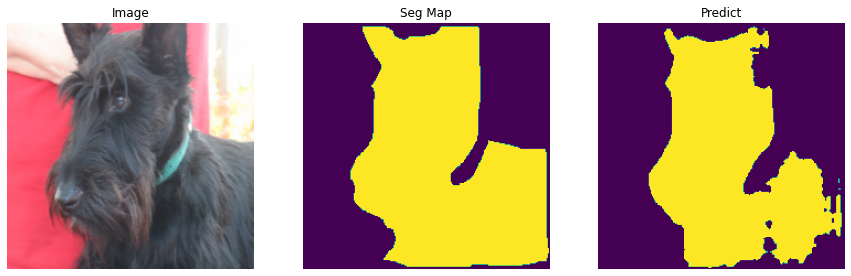

 Epoch: [8/30] - Train
Current Step: 50 	Train Loss: 0.7624741351604462, Train Iou: 0.7295917272567749


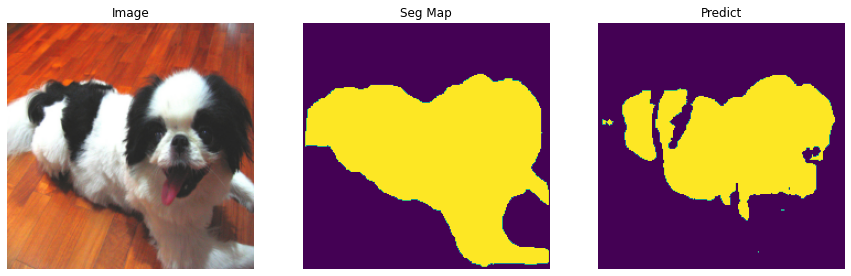

Current Step: 100 	Train Loss: 0.7618153309822082, Train Iou: 0.7317330241203308


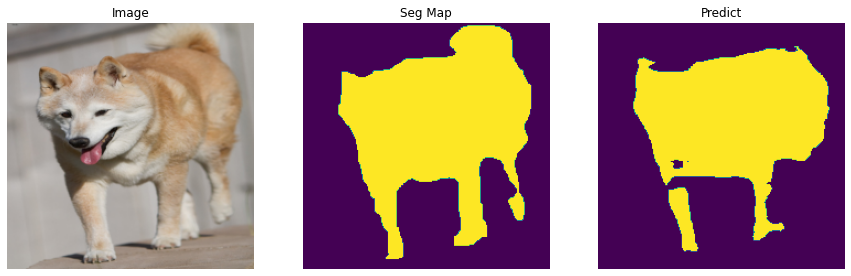

Current Step: 150 	Train Loss: 0.7543493700027466, Train Iou: 0.7383180260658264


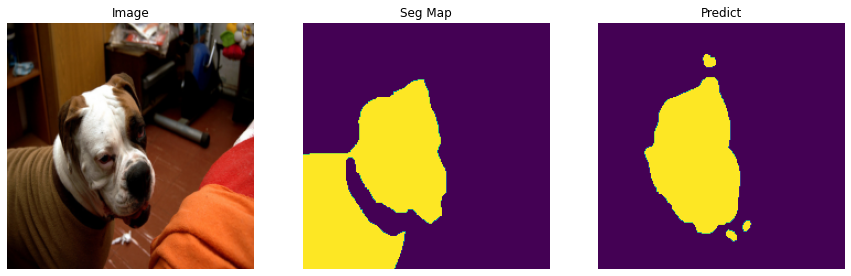

Current Step: 200 	Train Loss: 0.7538233852386474, Train Iou: 0.7368703484535217


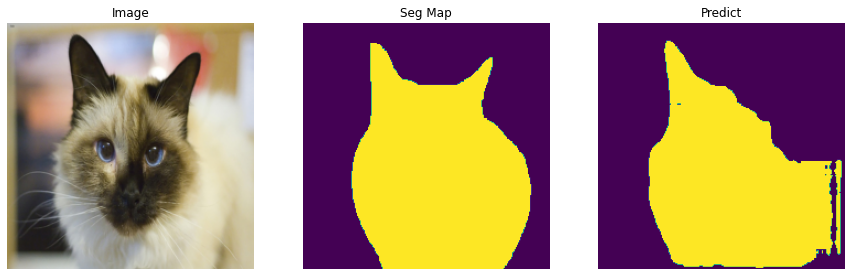

 Epoch: [8/30] - Validation
Validation step: Val Loss: 0.771355926990509, Val Iou: 0.687293529510498


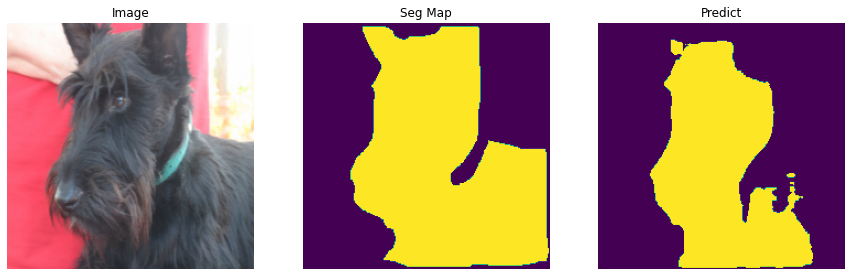

 Epoch: [9/30] - Train
Current Step: 50 	Train Loss: 0.7508078503608704, Train Iou: 0.7440144419670105


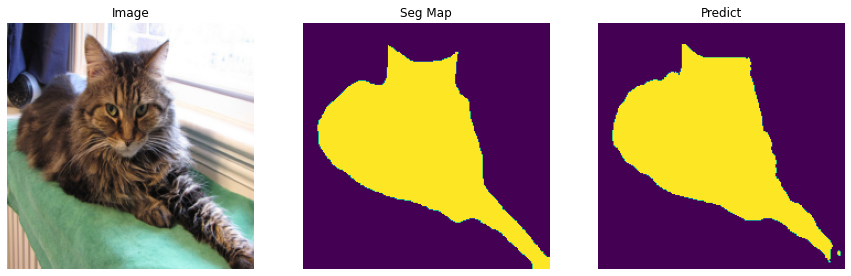

Current Step: 100 	Train Loss: 0.7397262811660766, Train Iou: 0.7538664937019348


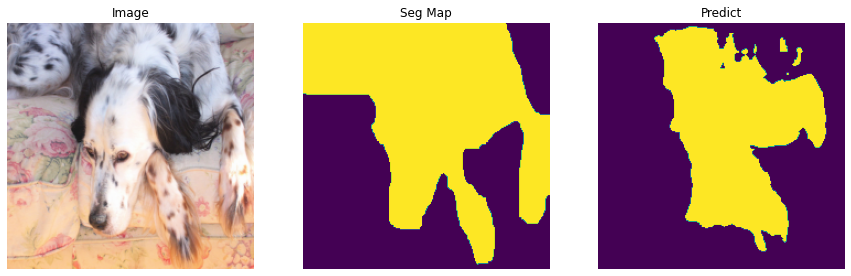

Current Step: 150 	Train Loss: 0.7470479738712311, Train Iou: 0.7504828572273254


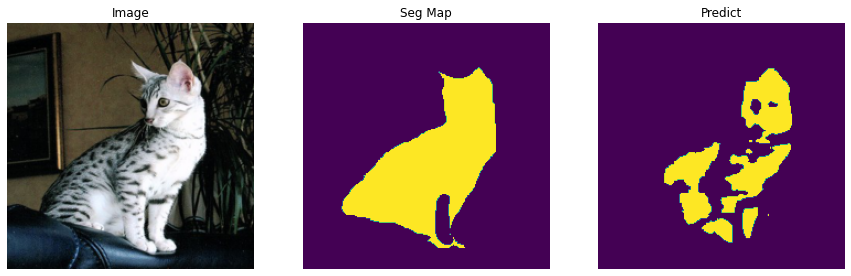

Current Step: 200 	Train Loss: 0.7354878330230713, Train Iou: 0.7563915848731995


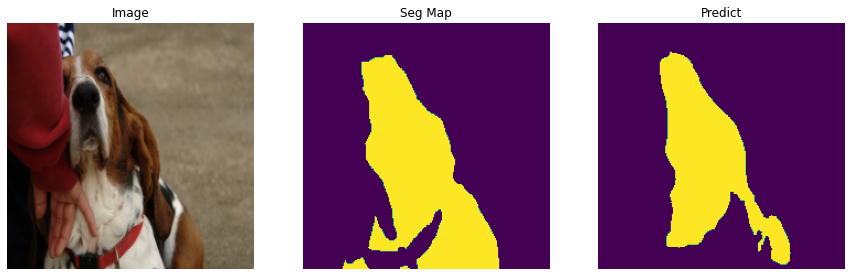

 Epoch: [9/30] - Validation
Validation step: Val Loss: 0.7345709800720215, Val Iou: 0.7566155195236206


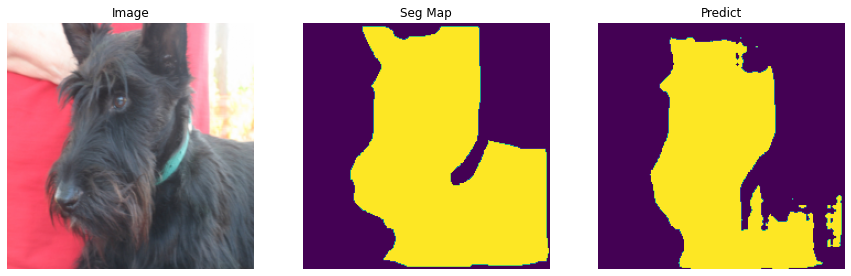

 Epoch: [10/30] - Train
Current Step: 50 	Train Loss: 0.730991929769516, Train Iou: 0.7654828429222107


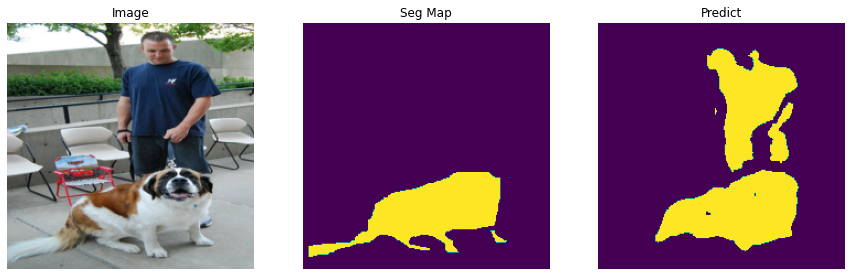

Current Step: 100 	Train Loss: 0.7360790061950684, Train Iou: 0.7597188353538513


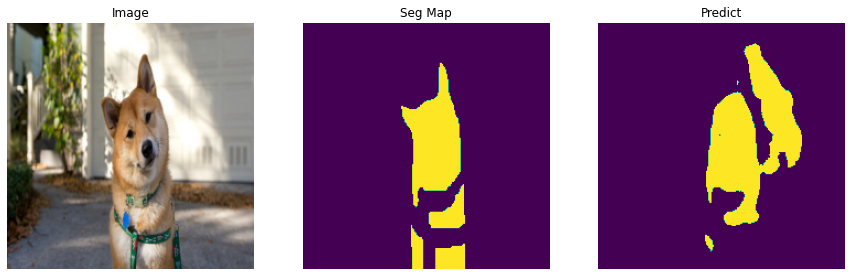

Current Step: 150 	Train Loss: 0.7311268651485443, Train Iou: 0.7668102383613586


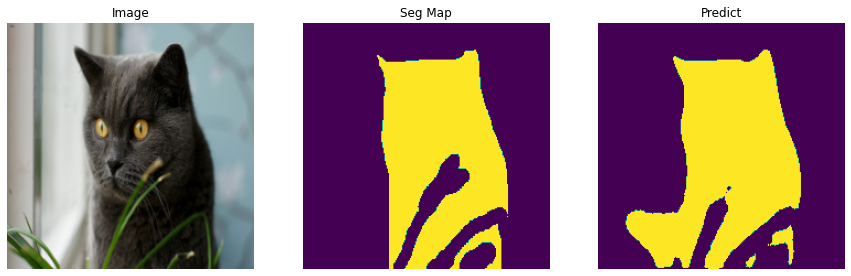

Current Step: 200 	Train Loss: 0.7317411565780639, Train Iou: 0.7665163278579712


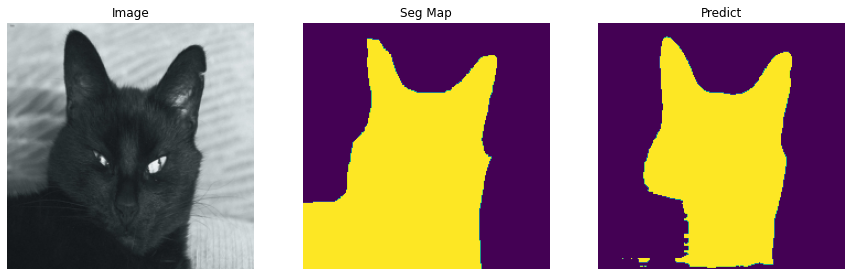

 Epoch: [10/30] - Validation
Validation step: Val Loss: 0.7226258516311646, Val Iou: 0.769334614276886


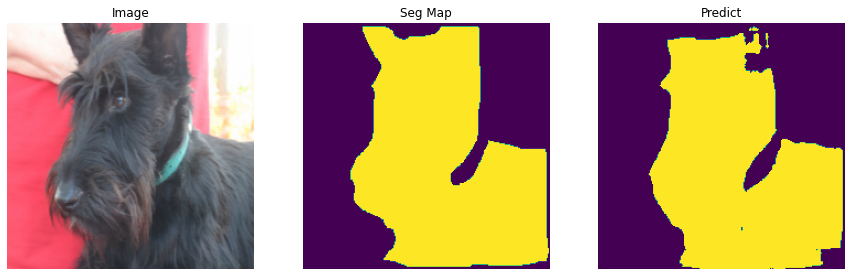

 Epoch: [11/30] - Train
Current Step: 50 	Train Loss: 0.7229116559028625, Train Iou: 0.7745977640151978


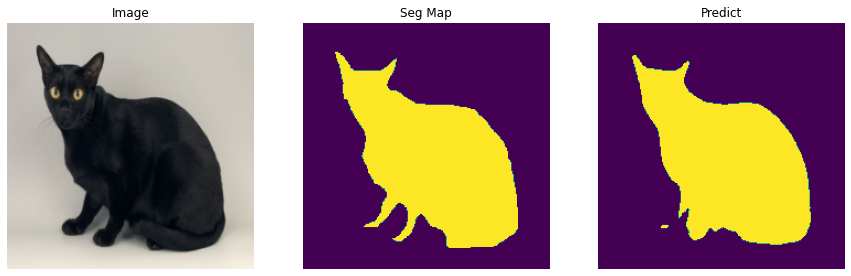

Current Step: 100 	Train Loss: 0.7208818686008454, Train Iou: 0.7783017754554749


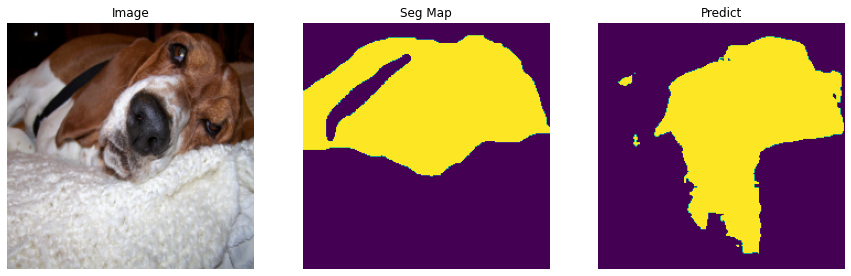

Current Step: 150 	Train Loss: 0.719993588924408, Train Iou: 0.7804928421974182


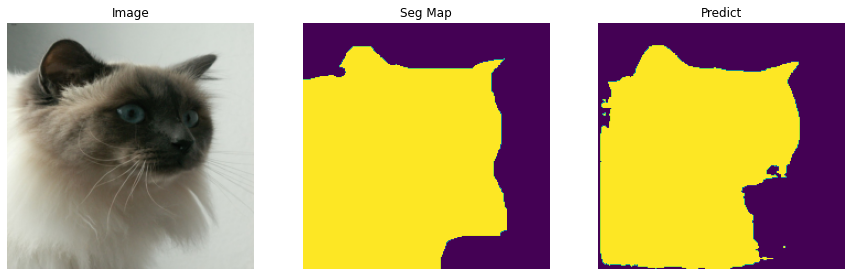

Current Step: 200 	Train Loss: 0.7198654782772064, Train Iou: 0.7788797616958618


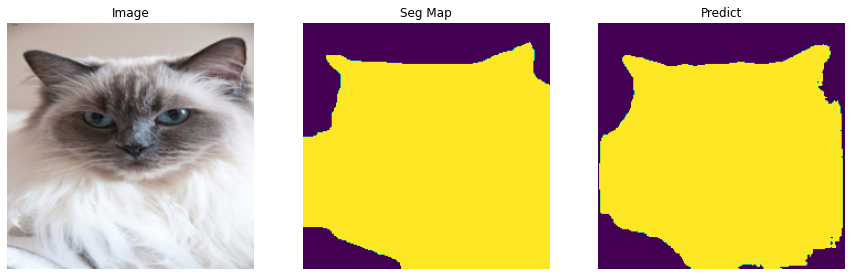

 Epoch: [11/30] - Validation
Validation step: Val Loss: 0.7130967378616333, Val Iou: 0.7880375385284424


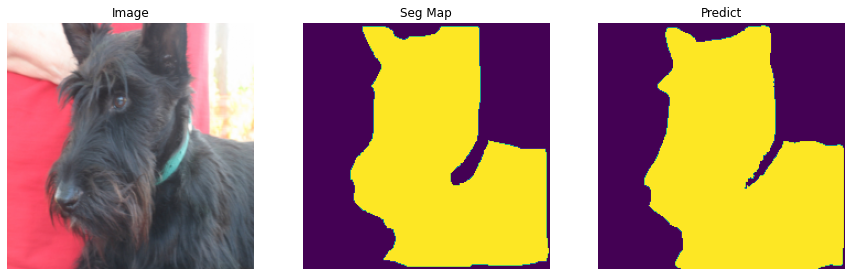

 Epoch: [12/30] - Train
Current Step: 50 	Train Loss: 0.7163351750373841, Train Iou: 0.7857513427734375


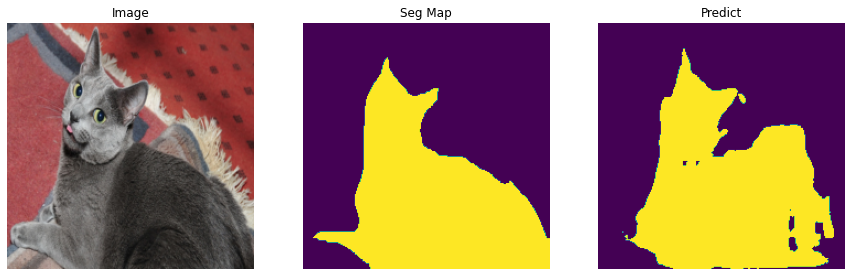

Current Step: 100 	Train Loss: 0.7067902541160583, Train Iou: 0.794450581073761


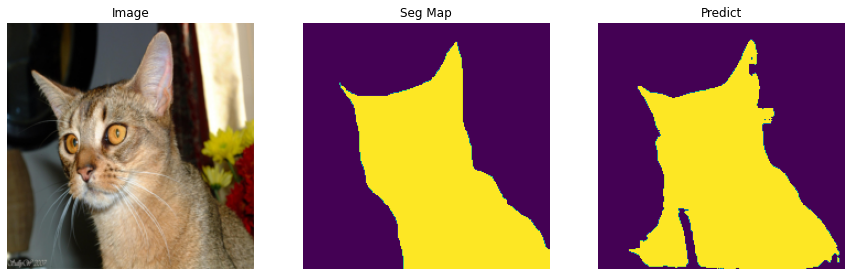

Current Step: 150 	Train Loss: 0.7034657227993012, Train Iou: 0.7964072227478027


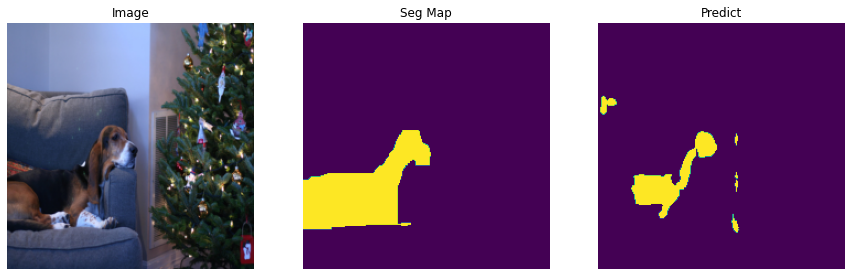

Current Step: 200 	Train Loss: 0.7148846447467804, Train Iou: 0.7841524481773376


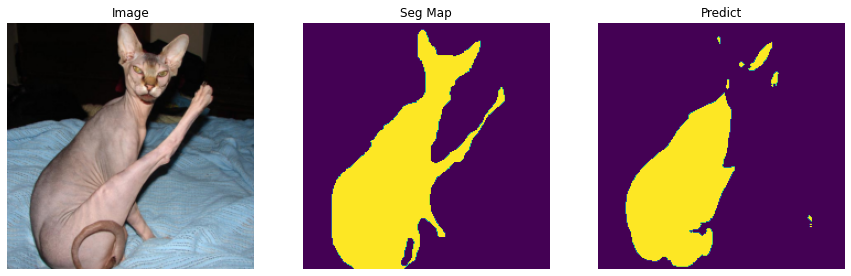

 Epoch: [12/30] - Validation
Validation step: Val Loss: 0.7534118294715881, Val Iou: 0.751969039440155


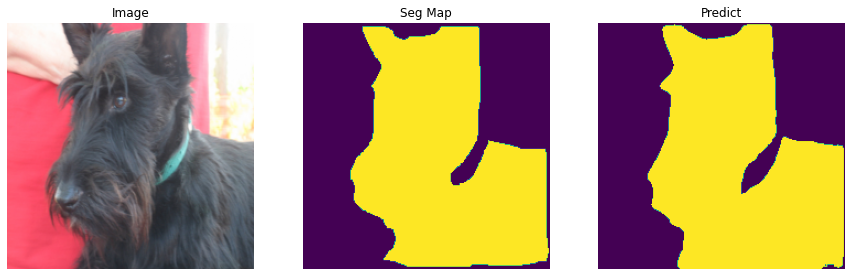

 Epoch: [13/30] - Train
Current Step: 50 	Train Loss: 0.7021918308734894, Train Iou: 0.7981621623039246


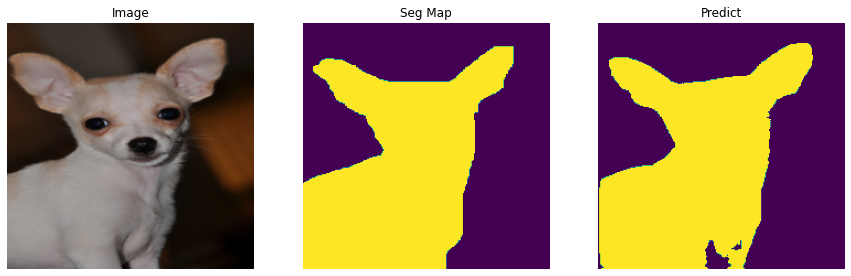

Current Step: 100 	Train Loss: 0.7050176727771759, Train Iou: 0.7970507740974426


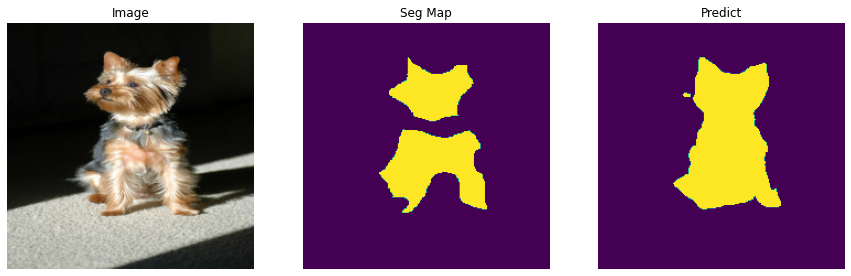

Current Step: 150 	Train Loss: 0.7026031696796418, Train Iou: 0.8009616136550903


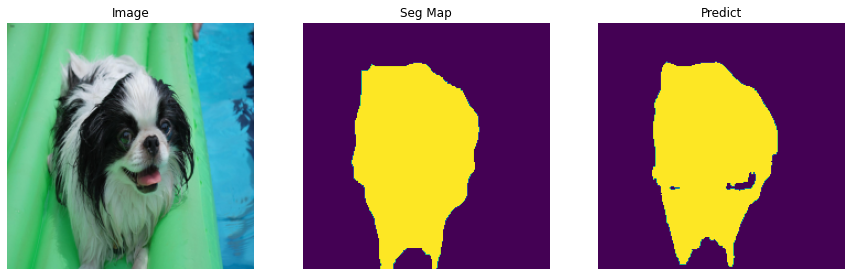

Current Step: 200 	Train Loss: 0.7102942895889283, Train Iou: 0.7934330701828003


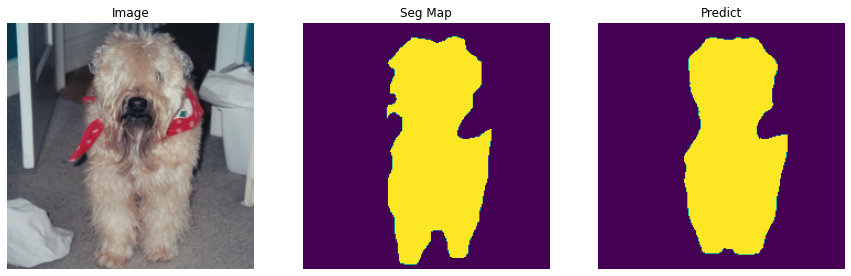

 Epoch: [13/30] - Validation
Validation step: Val Loss: 0.7365841865539551, Val Iou: 0.769233226776123


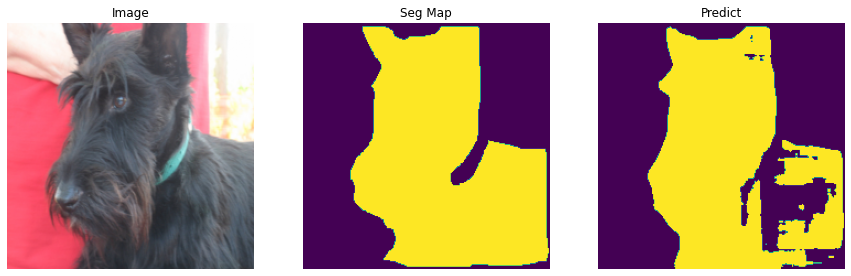

 Epoch: [14/30] - Train
Current Step: 50 	Train Loss: 0.6929394352436066, Train Iou: 0.8129507303237915


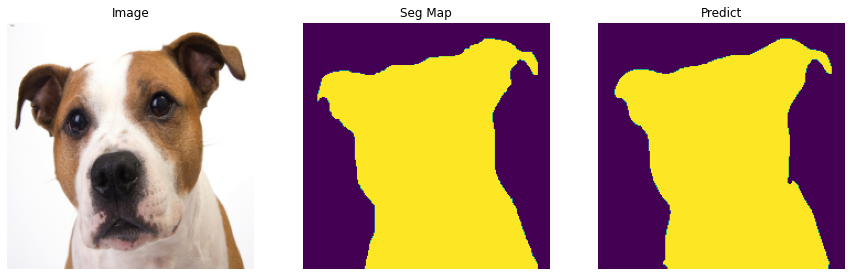

Current Step: 100 	Train Loss: 0.701161823272705, Train Iou: 0.8051694631576538


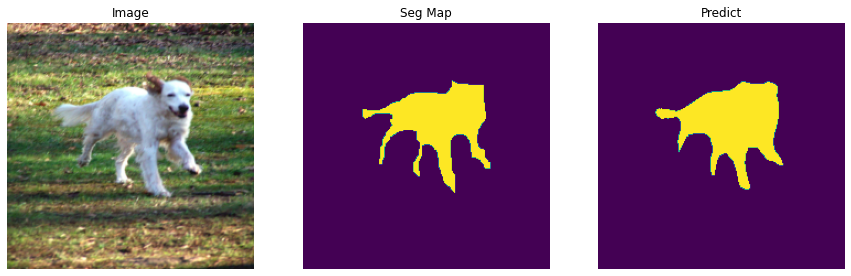

Current Step: 150 	Train Loss: 0.6940796148777008, Train Iou: 0.8066596388816833


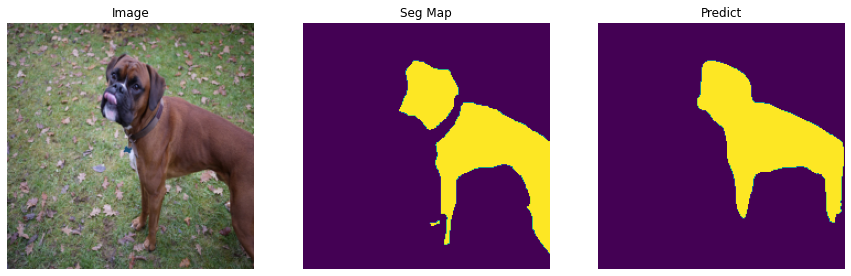

Current Step: 200 	Train Loss: 0.6947517693042755, Train Iou: 0.8086413741111755


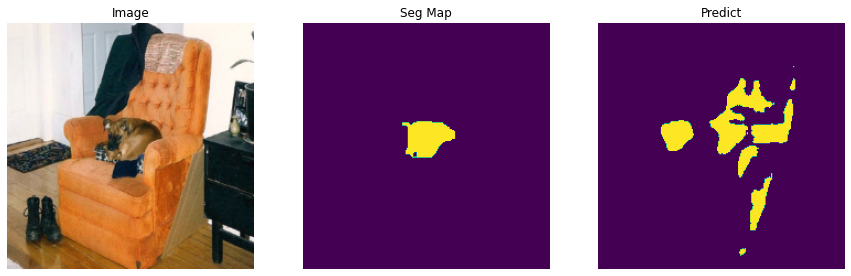

 Epoch: [14/30] - Validation
Validation step: Val Loss: 0.7069925665855408, Val Iou: 0.7910673022270203


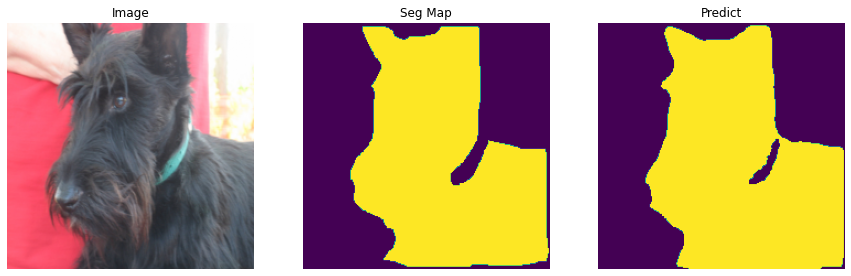

 Epoch: [15/30] - Train
Current Step: 50 	Train Loss: 0.6791952478885651, Train Iou: 0.8216435313224792


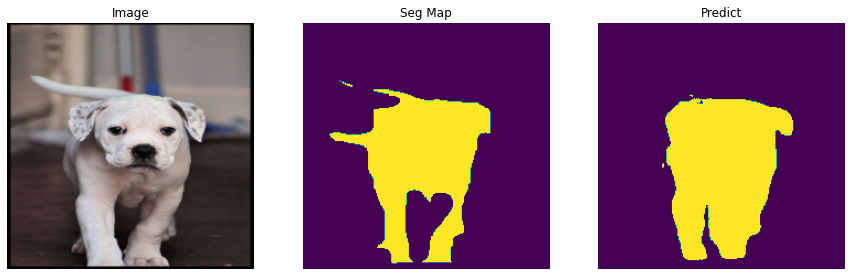

Current Step: 100 	Train Loss: 0.6924360179901123, Train Iou: 0.8157722353935242


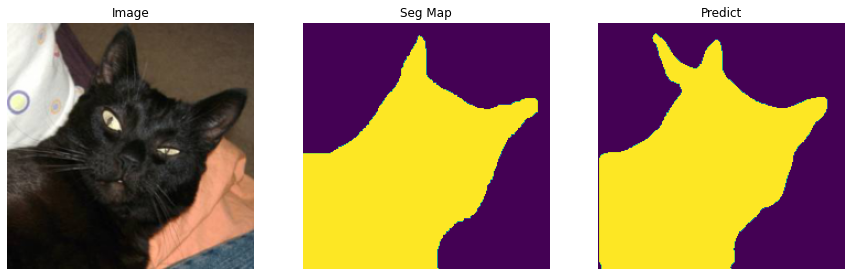

Current Step: 150 	Train Loss: 0.6878459703922272, Train Iou: 0.817462682723999


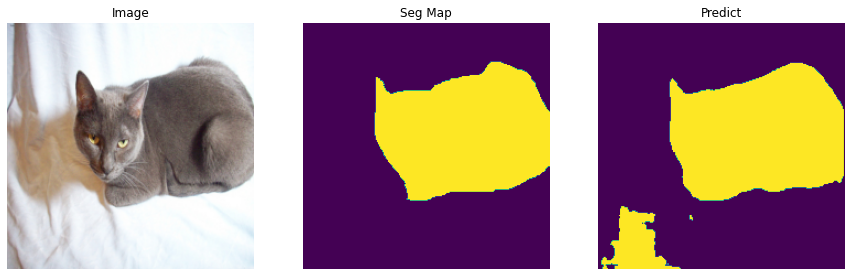

Current Step: 200 	Train Loss: 0.6855693566799164, Train Iou: 0.819856584072113


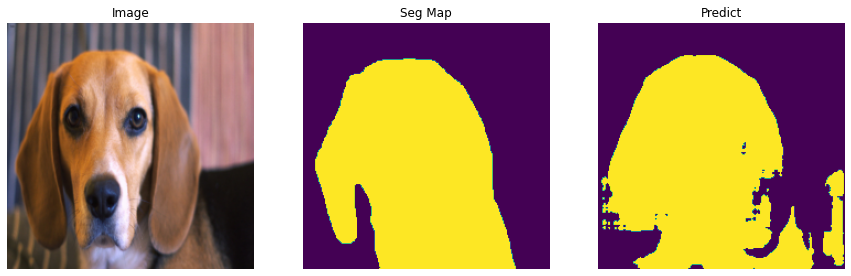

 Epoch: [15/30] - Validation
Validation step: Val Loss: 0.7016447186470032, Val Iou: 0.7944937944412231


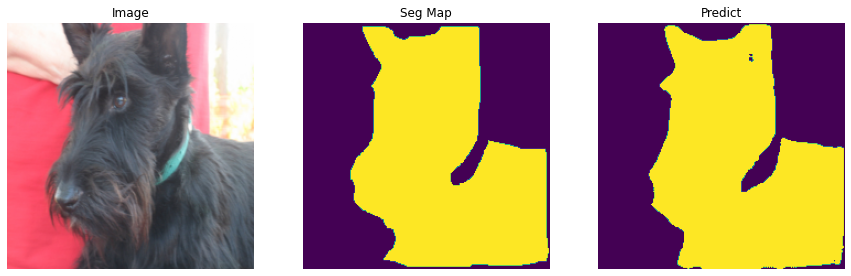

 Epoch: [16/30] - Train
Current Step: 50 	Train Loss: 0.6736595022678376, Train Iou: 0.8351619839668274


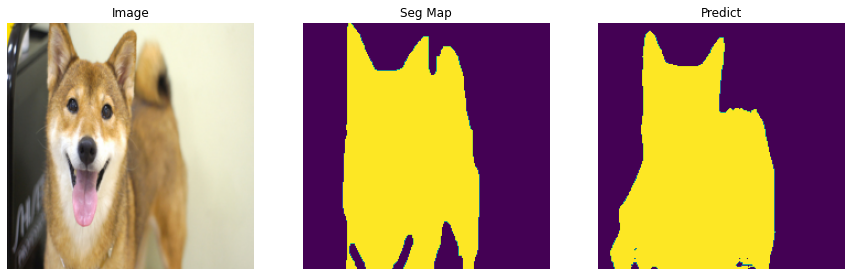

Current Step: 100 	Train Loss: 0.6786434042453766, Train Iou: 0.8240591287612915


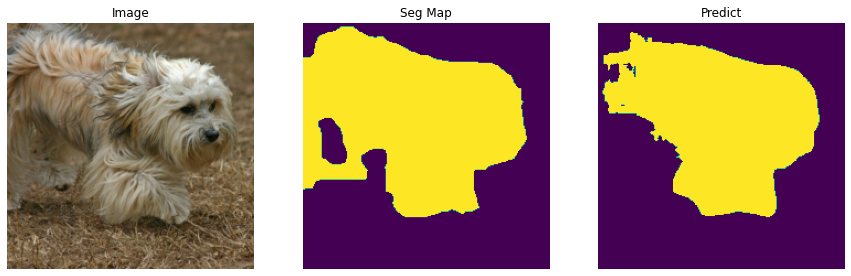

Current Step: 150 	Train Loss: 0.680695207118988, Train Iou: 0.8252095580101013


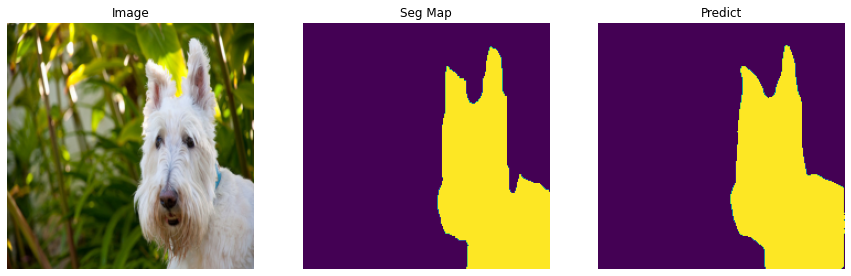

Current Step: 200 	Train Loss: 0.6798022472858429, Train Iou: 0.8233932256698608


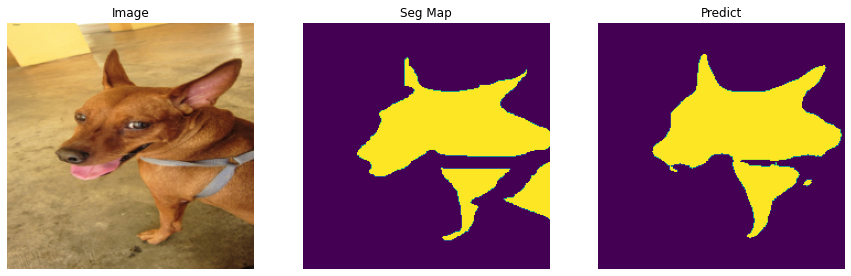

 Epoch: [16/30] - Validation
Validation step: Val Loss: 0.7007891535758972, Val Iou: 0.797319769859314


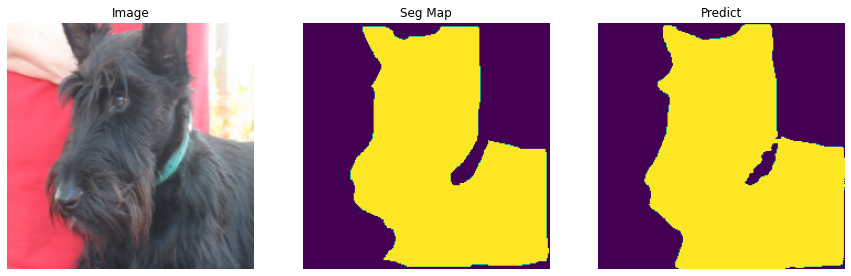

 Epoch: [17/30] - Train
Current Step: 50 	Train Loss: 0.6716442024707794, Train Iou: 0.8399070501327515


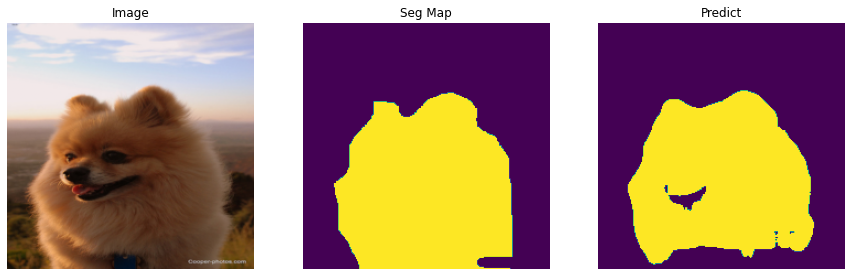

Current Step: 100 	Train Loss: 0.6713866770267487, Train Iou: 0.8356340527534485


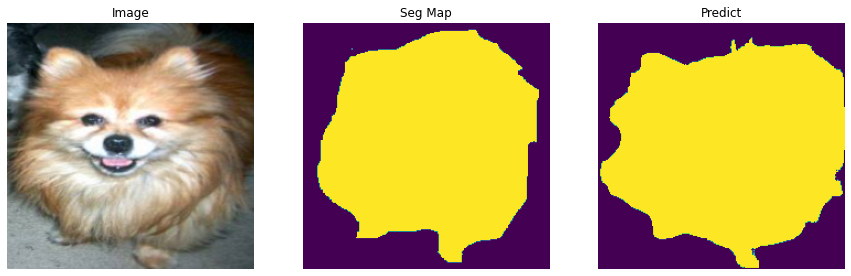

Current Step: 150 	Train Loss: 0.669203644990921, Train Iou: 0.844750165939331


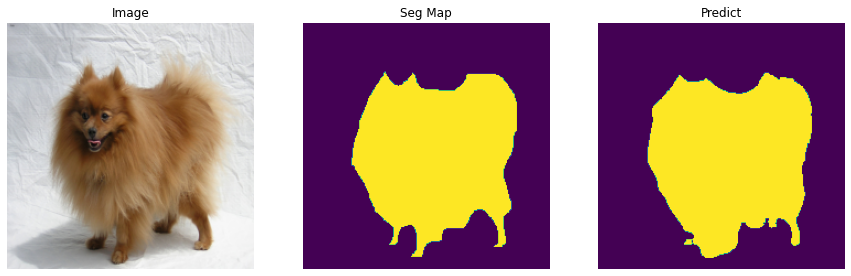

Current Step: 200 	Train Loss: 0.6552774429321289, Train Iou: 0.8447405099868774


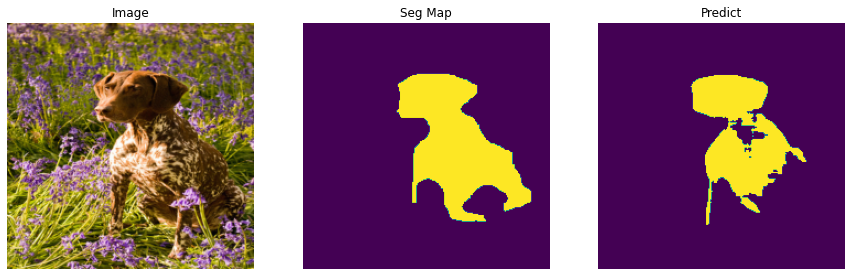

 Epoch: [17/30] - Validation
Validation step: Val Loss: 0.7123597264289856, Val Iou: 0.7934267520904541


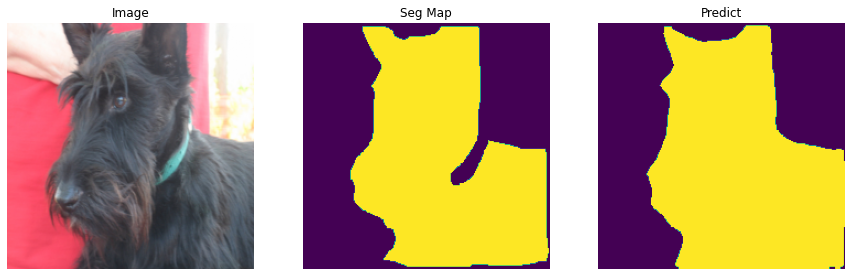

 Epoch: [18/30] - Train
Current Step: 50 	Train Loss: 0.6691065275669098, Train Iou: 0.8413942456245422


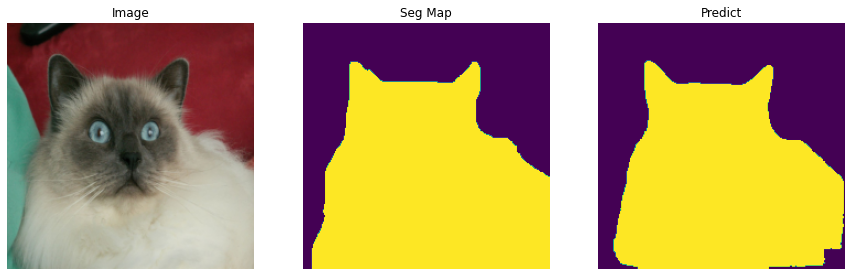

Current Step: 100 	Train Loss: 0.6493263483047486, Train Iou: 0.8540480732917786


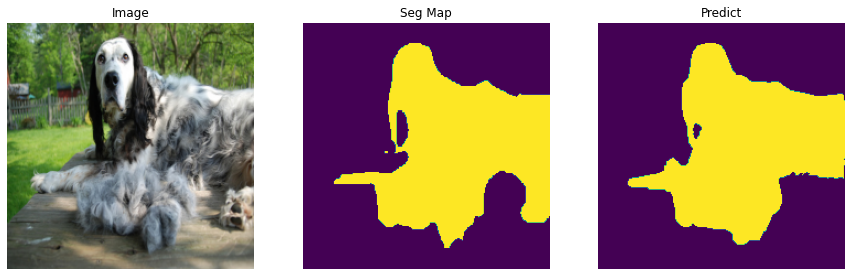

Current Step: 150 	Train Loss: 0.6636778533458709, Train Iou: 0.8472652435302734


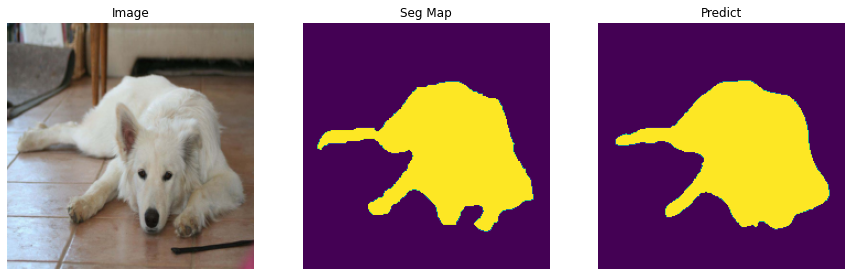

Current Step: 200 	Train Loss: 0.6566458535194397, Train Iou: 0.8520737290382385


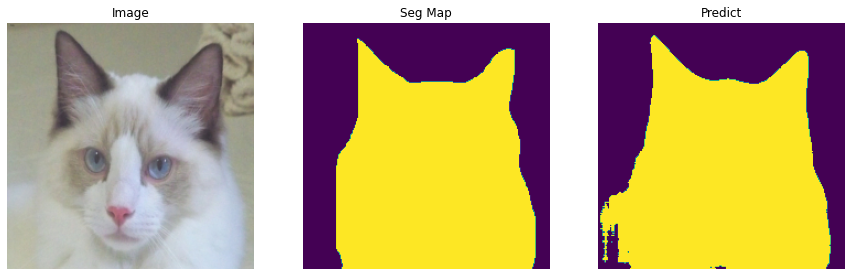

 Epoch: [18/30] - Validation
Validation step: Val Loss: 0.7029213309288025, Val Iou: 0.8034982681274414


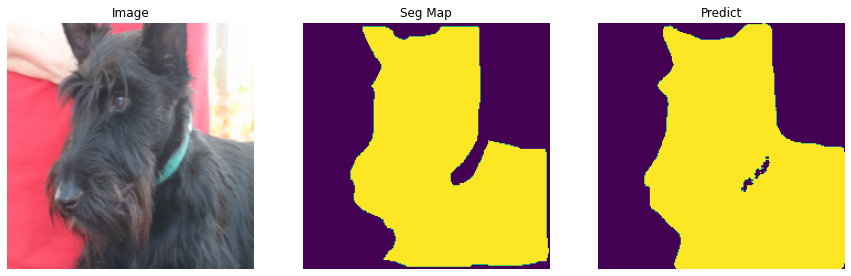

 Epoch: [19/30] - Train
Current Step: 50 	Train Loss: 0.642059485912323, Train Iou: 0.8630212545394897


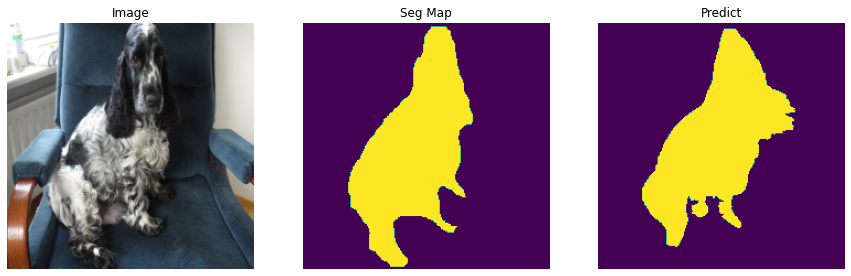

Current Step: 100 	Train Loss: 0.6601804518699645, Train Iou: 0.8554012179374695


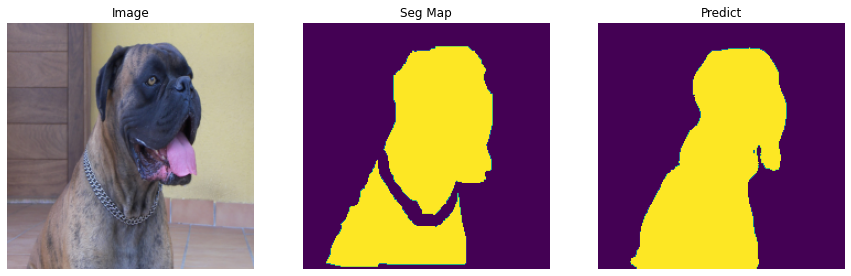

Current Step: 150 	Train Loss: 0.6635786247253418, Train Iou: 0.8472846746444702


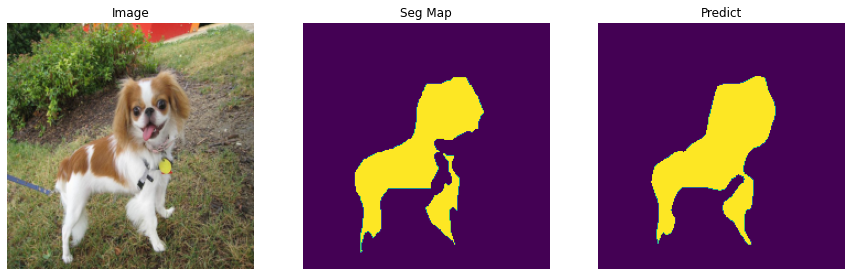

Current Step: 200 	Train Loss: 0.6521306133270264, Train Iou: 0.8547418117523193


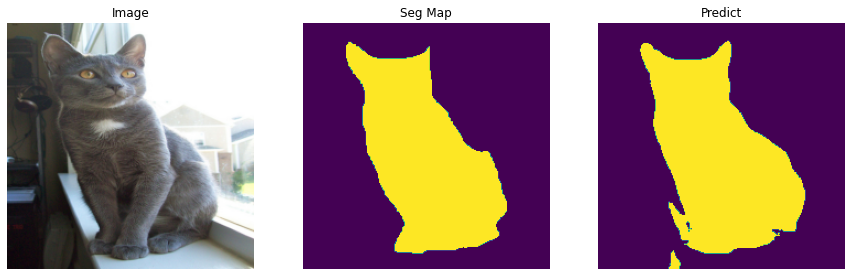

 Epoch: [19/30] - Validation
Validation step: Val Loss: 0.7052437663078308, Val Iou: 0.8033038973808289


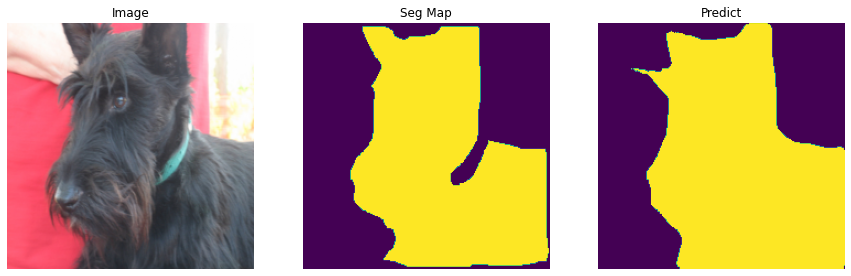

 Epoch: [20/30] - Train
Current Step: 50 	Train Loss: 0.6482244598865509, Train Iou: 0.8603734374046326


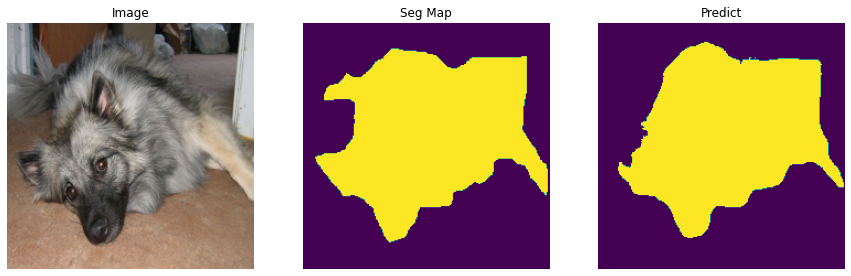

Current Step: 100 	Train Loss: 0.6546040320396423, Train Iou: 0.8591719269752502


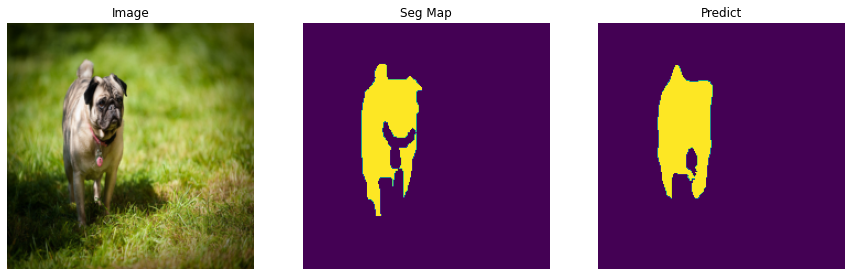

Current Step: 150 	Train Loss: 0.646238181591034, Train Iou: 0.8648030161857605


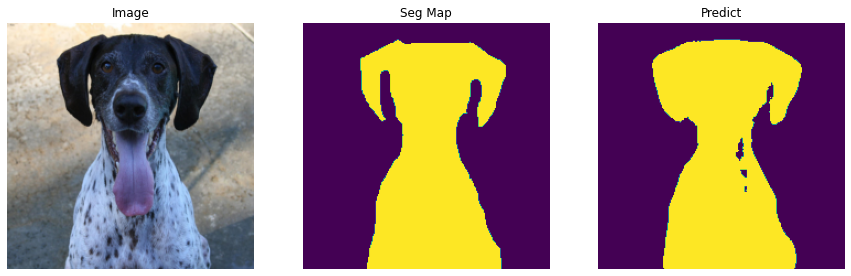

Current Step: 200 	Train Loss: 0.6468816280364991, Train Iou: 0.8628023266792297


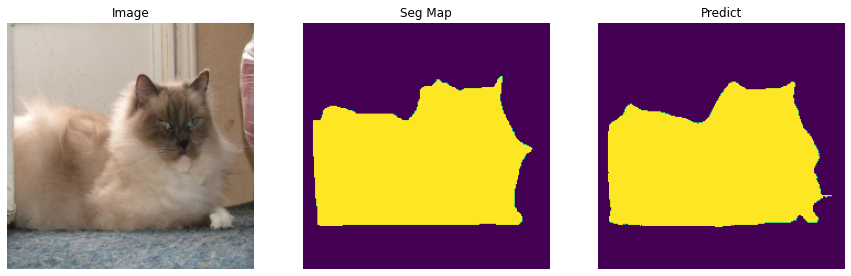

 Epoch: [20/30] - Validation
Validation step: Val Loss: 0.7001569867134094, Val Iou: 0.8064276576042175


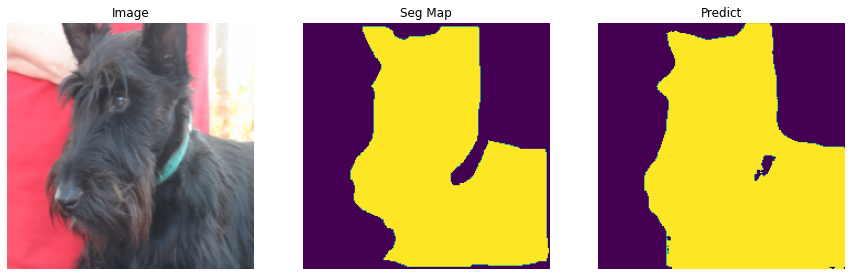

 Epoch: [21/30] - Train
Current Step: 50 	Train Loss: 0.6370379066467285, Train Iou: 0.8733526468276978


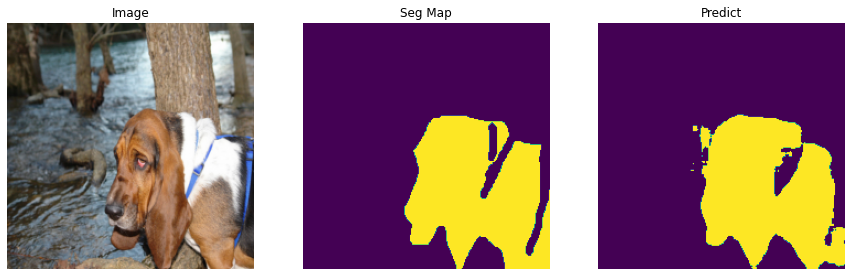

Current Step: 100 	Train Loss: 0.6345473420619965, Train Iou: 0.8809092044830322


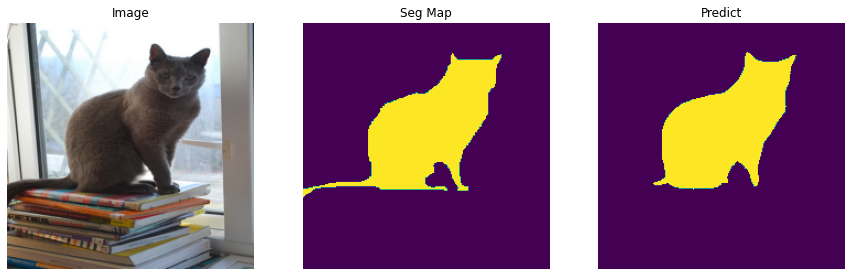

Current Step: 150 	Train Loss: 0.6311273157596589, Train Iou: 0.8746421933174133


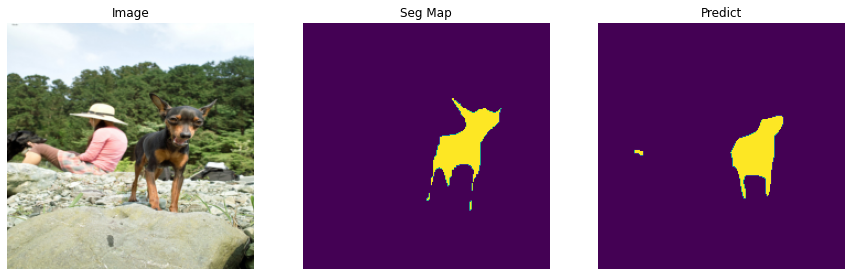

Current Step: 200 	Train Loss: 0.6501992428302765, Train Iou: 0.863078773021698


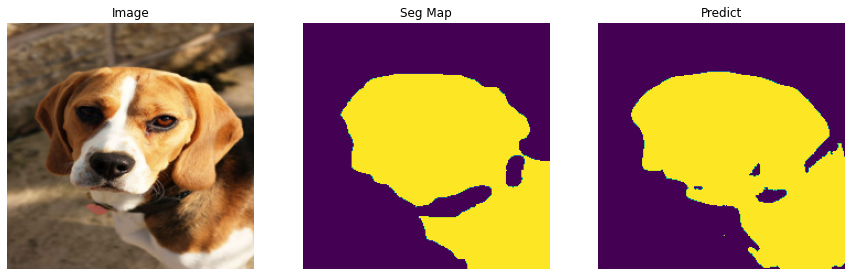

 Epoch: [21/30] - Validation
Validation step: Val Loss: 0.7495296597480774, Val Iou: 0.7557058334350586


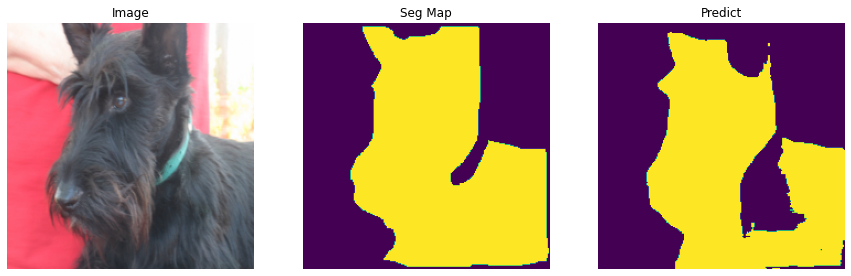

 Epoch: [22/30] - Train
Current Step: 50 	Train Loss: 0.6295888650417328, Train Iou: 0.8840392827987671


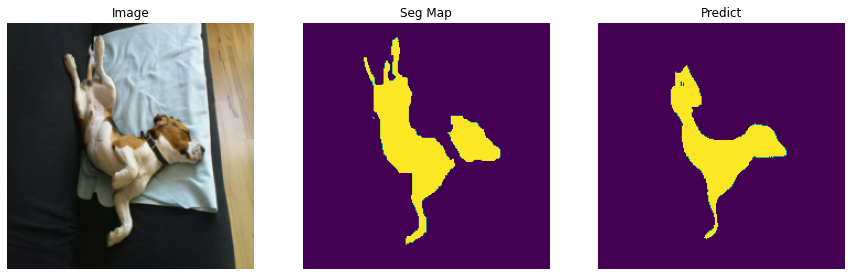

Current Step: 100 	Train Loss: 0.6316212248802185, Train Iou: 0.8842092752456665


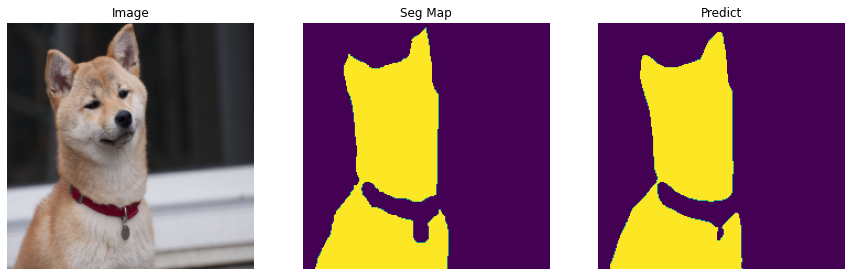

Current Step: 150 	Train Loss: 0.6262899994850158, Train Iou: 0.8878771066665649


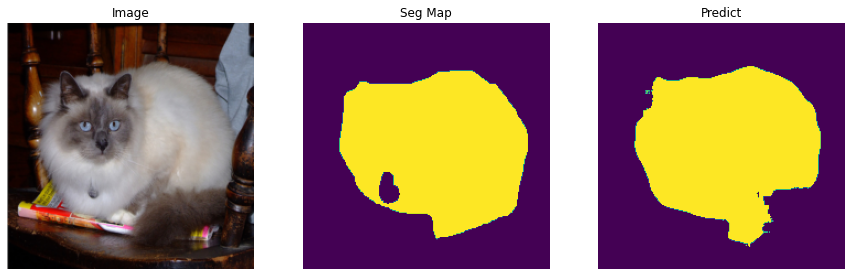

Current Step: 200 	Train Loss: 0.627583122253418, Train Iou: 0.8814707398414612


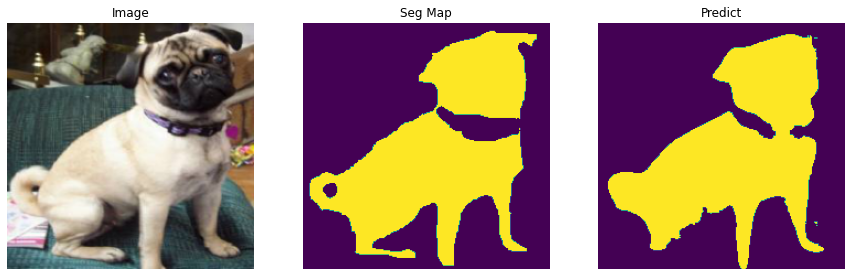

 Epoch: [22/30] - Validation
Validation step: Val Loss: 0.7083027362823486, Val Iou: 0.8022997975349426


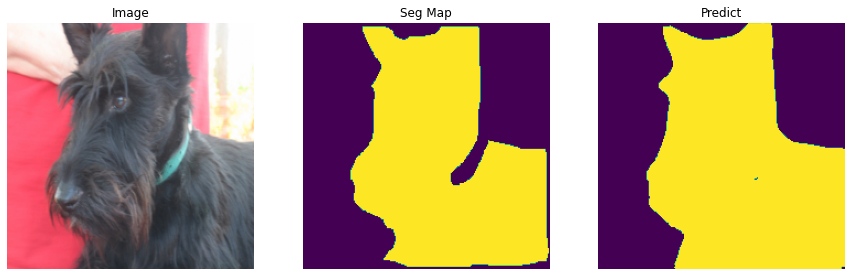

 Epoch: [23/30] - Train
Current Step: 50 	Train Loss: 0.6163155019283295, Train Iou: 0.8931555151939392


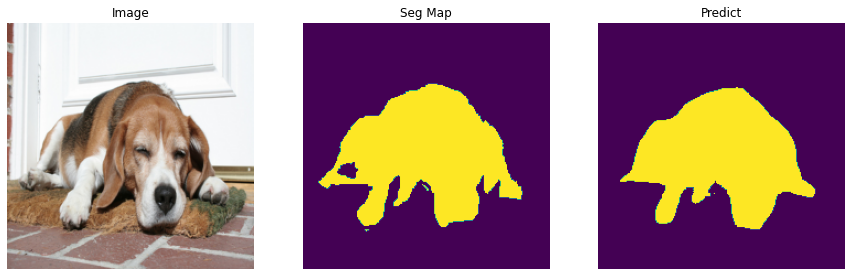

Current Step: 100 	Train Loss: 0.6251820242404937, Train Iou: 0.891865074634552


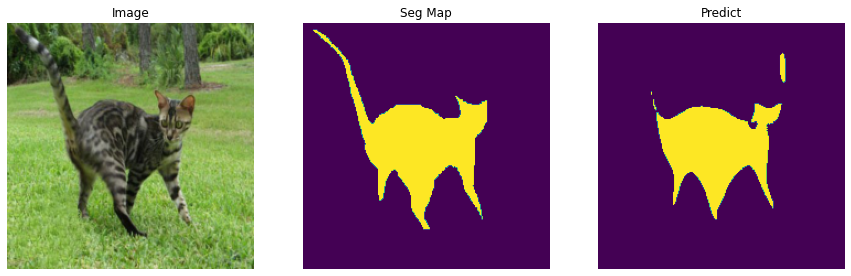

Current Step: 150 	Train Loss: 0.6234952187538148, Train Iou: 0.8914171457290649


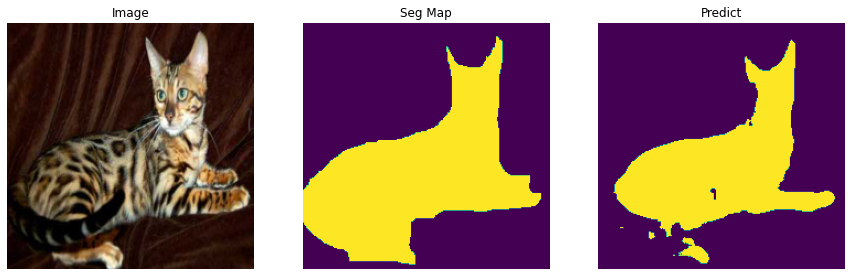

Current Step: 200 	Train Loss: 0.6299535572528839, Train Iou: 0.8834524750709534


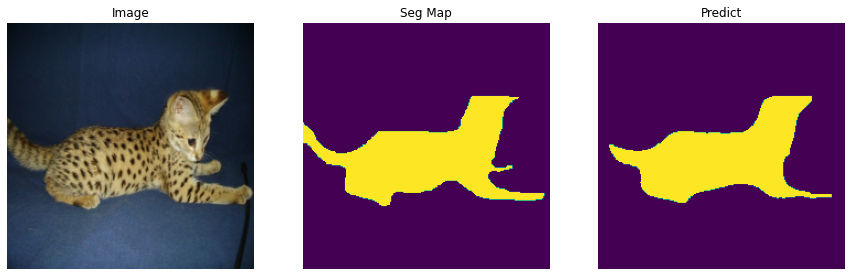

 Epoch: [23/30] - Validation
Validation step: Val Loss: 0.6967430710792542, Val Iou: 0.8136149644851685


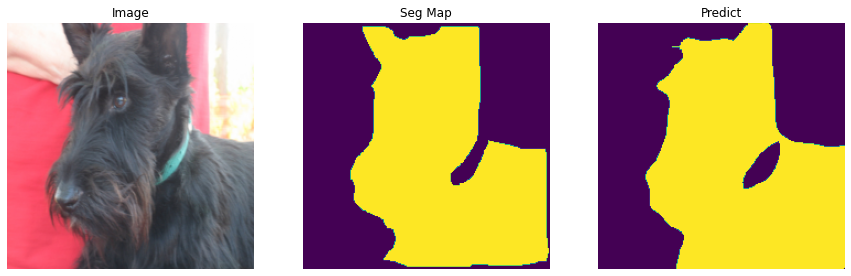

 Epoch: [24/30] - Train
Current Step: 50 	Train Loss: 0.6188005292415619, Train Iou: 0.8951061367988586


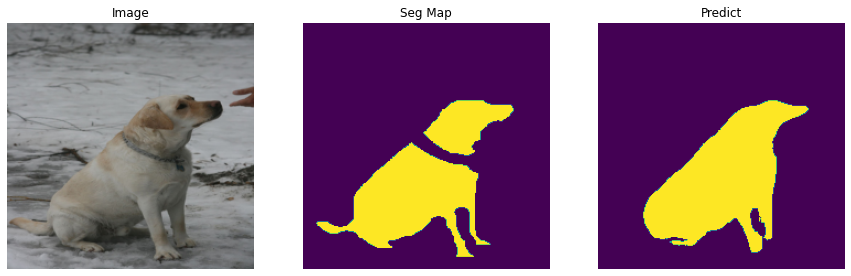

Current Step: 100 	Train Loss: 0.6129569578170776, Train Iou: 0.8993078470230103


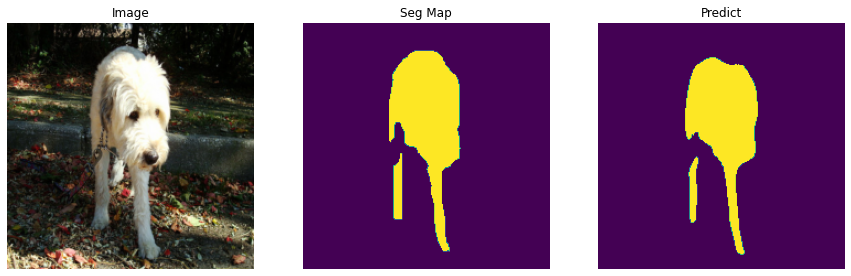

Current Step: 150 	Train Loss: 0.6234098935127258, Train Iou: 0.8900727033615112


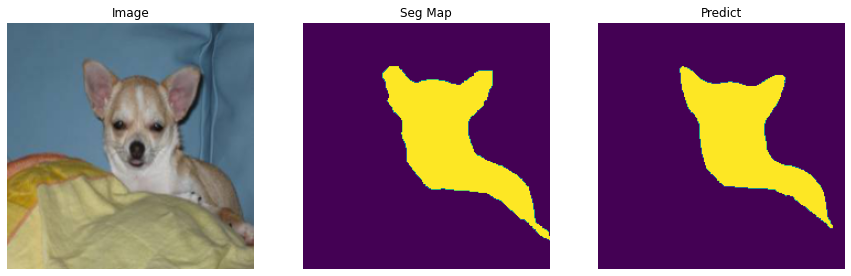

Current Step: 200 	Train Loss: 0.6258503484725952, Train Iou: 0.8921054005622864


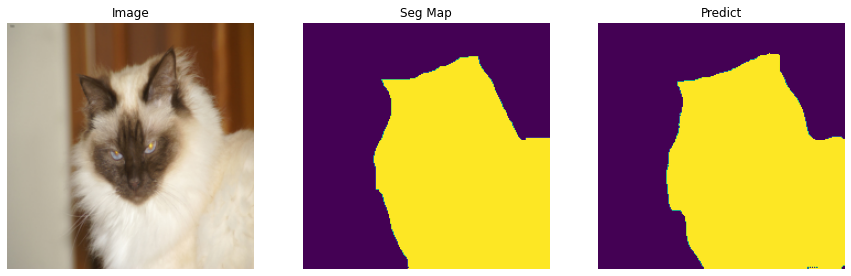

 Epoch: [24/30] - Validation
Validation step: Val Loss: 0.7023500800132751, Val Iou: 0.8067005276679993


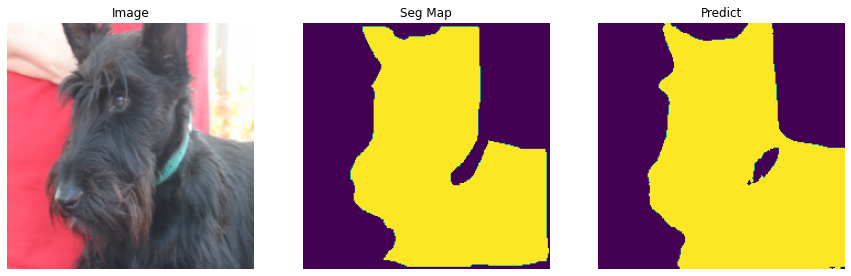

 Epoch: [25/30] - Train
Current Step: 50 	Train Loss: 0.6135600972175598, Train Iou: 0.8988659381866455


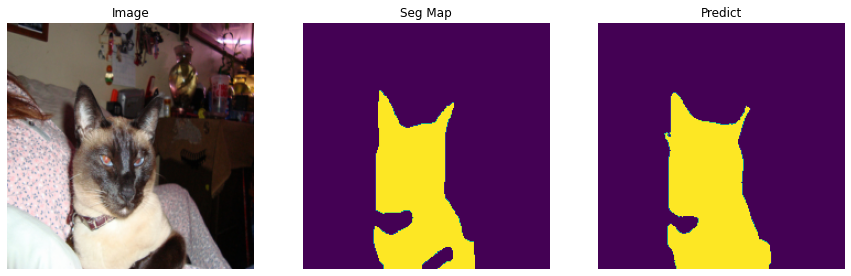

Current Step: 100 	Train Loss: 0.6200160646438598, Train Iou: 0.8989032506942749


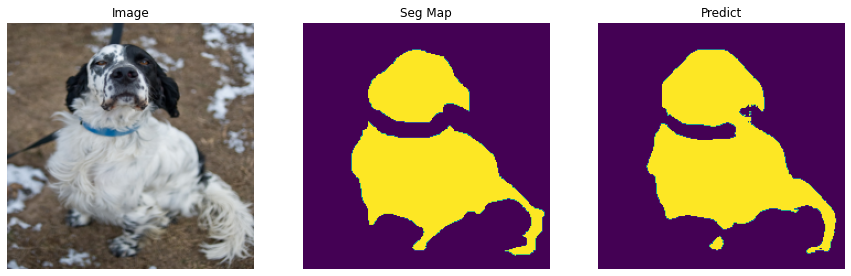

Current Step: 150 	Train Loss: 0.6113495826721191, Train Iou: 0.902648389339447


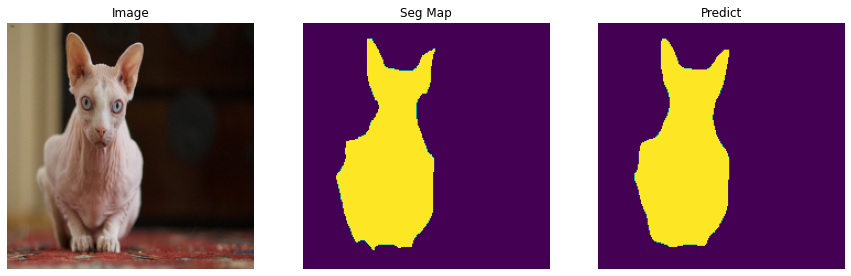

Current Step: 200 	Train Loss: 0.6234365773200988, Train Iou: 0.8920209407806396


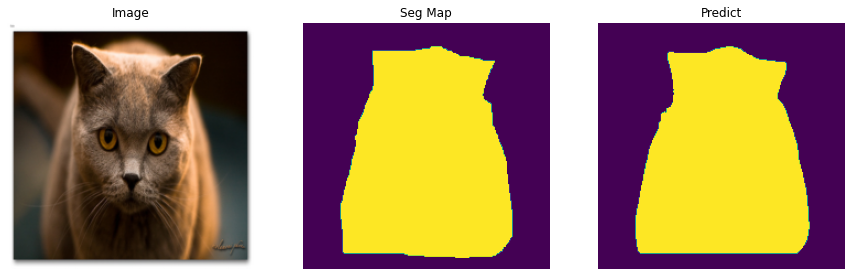

 Epoch: [25/30] - Validation
Validation step: Val Loss: 0.6976640224456787, Val Iou: 0.8099028468132019


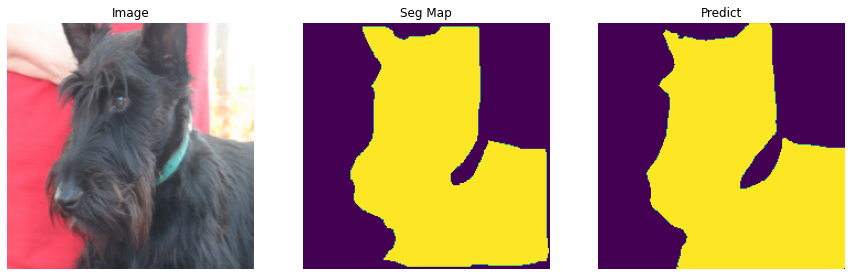

 Epoch: [26/30] - Train
Current Step: 50 	Train Loss: 0.6346860527992249, Train Iou: 0.8792517185211182


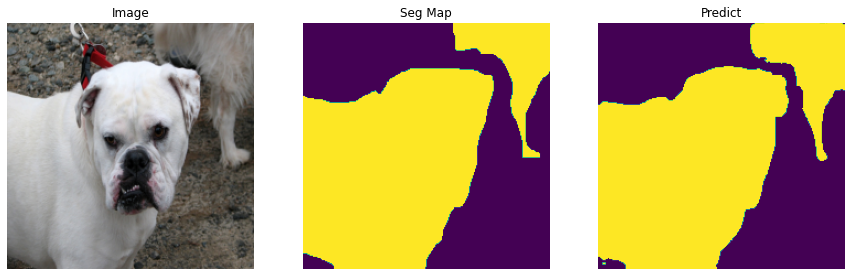

Current Step: 100 	Train Loss: 0.6164489722251892, Train Iou: 0.8890739679336548


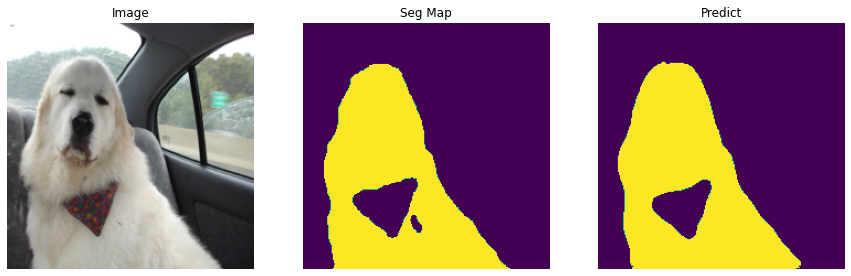

Current Step: 150 	Train Loss: 0.6256342971324921, Train Iou: 0.8902453780174255


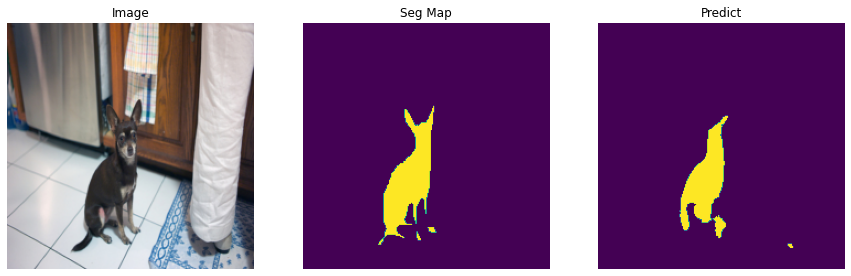

Current Step: 200 	Train Loss: 0.6262069475650788, Train Iou: 0.8941482305526733


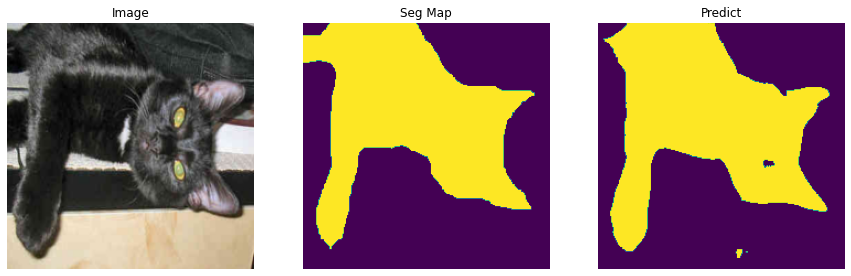

 Epoch: [26/30] - Validation
Validation step: Val Loss: 0.7330973148345947, Val Iou: 0.810764729976654


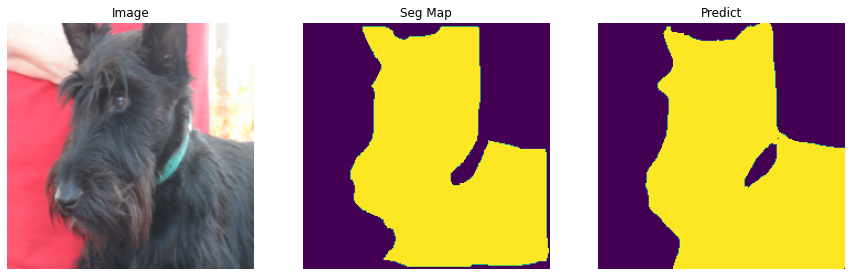

 Epoch: [27/30] - Train
Current Step: 50 	Train Loss: 0.6100600123405456, Train Iou: 0.9040650129318237


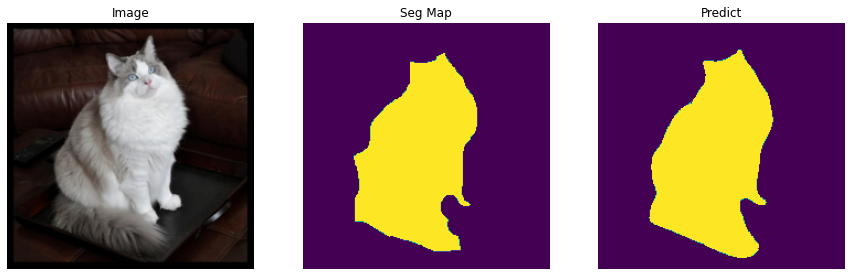

Current Step: 100 	Train Loss: 0.6149714541435242, Train Iou: 0.905531644821167


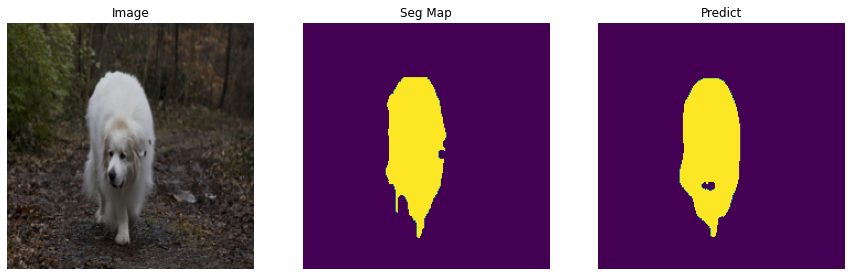

Current Step: 150 	Train Loss: 0.6052069878578186, Train Iou: 0.9081394672393799


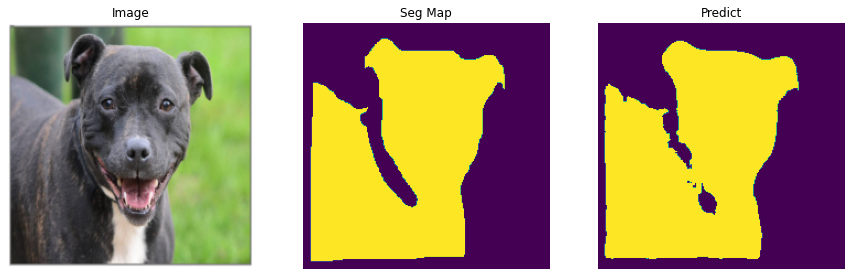

Current Step: 200 	Train Loss: 0.6112885713577271, Train Iou: 0.9067965745925903


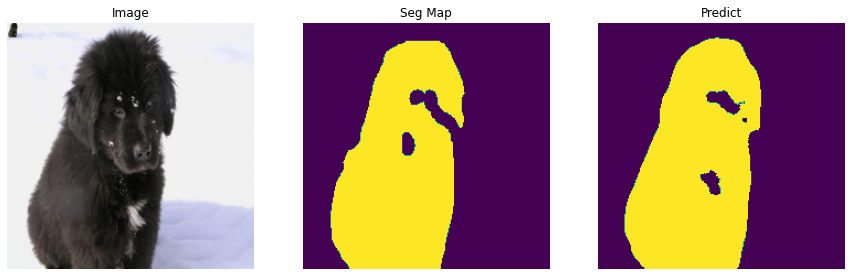

 Epoch: [27/30] - Validation
Validation step: Val Loss: 0.7009792327880859, Val Iou: 0.8175069689750671


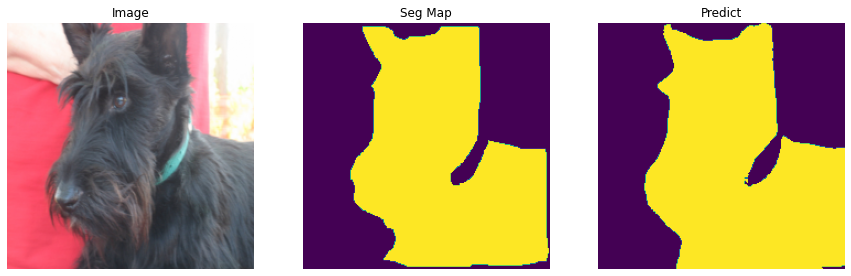

 Epoch: [28/30] - Train
Current Step: 50 	Train Loss: 0.6121112084388733, Train Iou: 0.9083287715911865


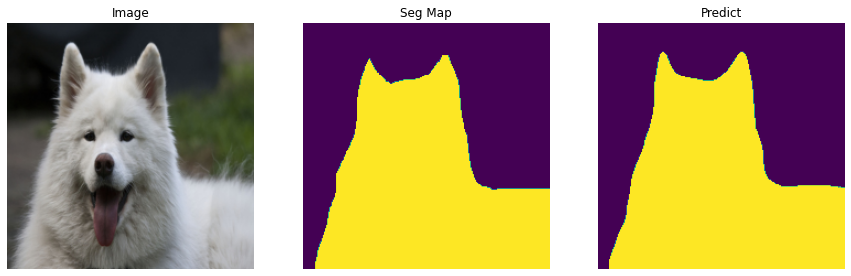

Current Step: 100 	Train Loss: 0.6115798854827881, Train Iou: 0.909586489200592


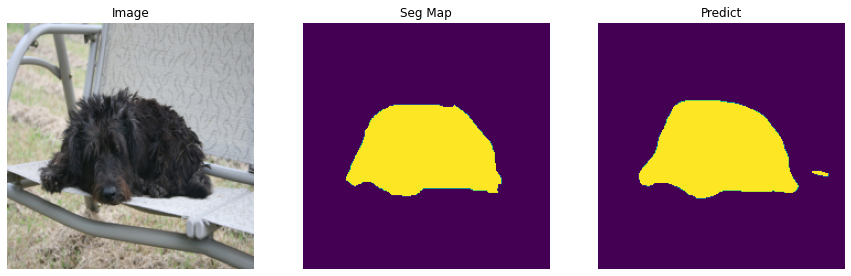

Current Step: 150 	Train Loss: 0.6049464857578277, Train Iou: 0.9116125702857971


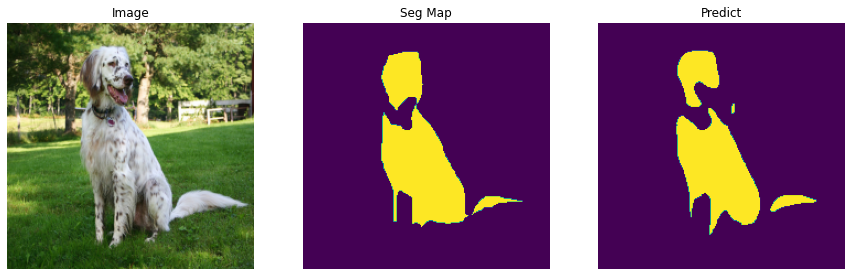

Current Step: 200 	Train Loss: 0.5975707256793976, Train Iou: 0.9140748381614685


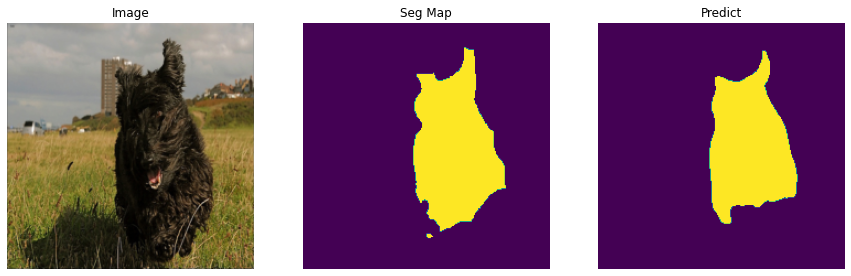

 Epoch: [28/30] - Validation
Validation step: Val Loss: 0.7105038166046143, Val Iou: 0.8225479125976562


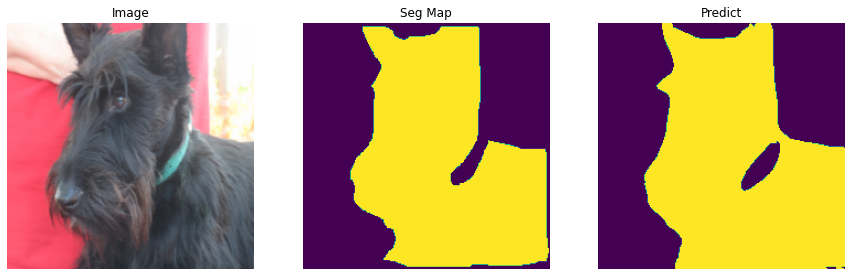

 Epoch: [29/30] - Train
Current Step: 50 	Train Loss: 0.5989755868911744, Train Iou: 0.9163106679916382


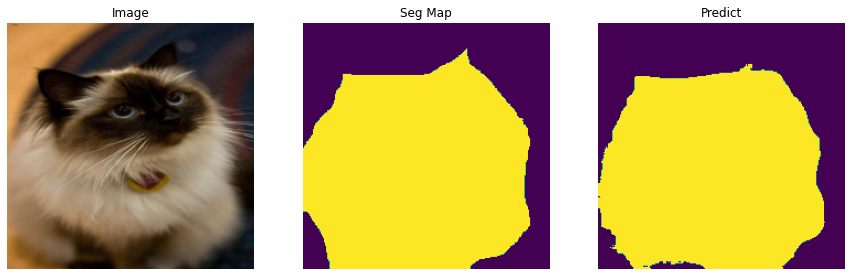

Current Step: 100 	Train Loss: 0.602836184501648, Train Iou: 0.9158110618591309


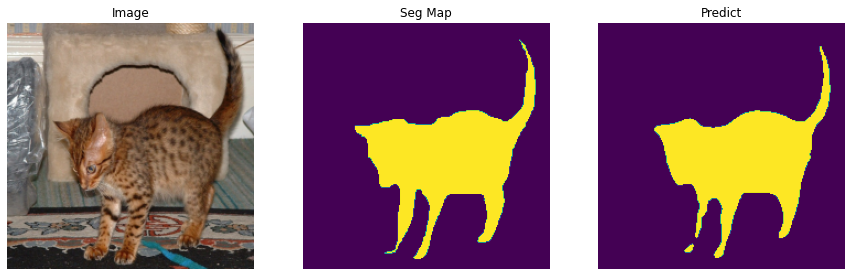

Current Step: 150 	Train Loss: 0.5993507754802704, Train Iou: 0.9167383313179016


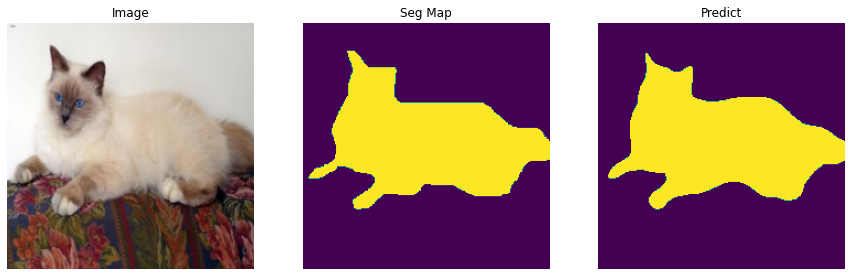

Current Step: 200 	Train Loss: 0.6055785775184631, Train Iou: 0.9140437245368958


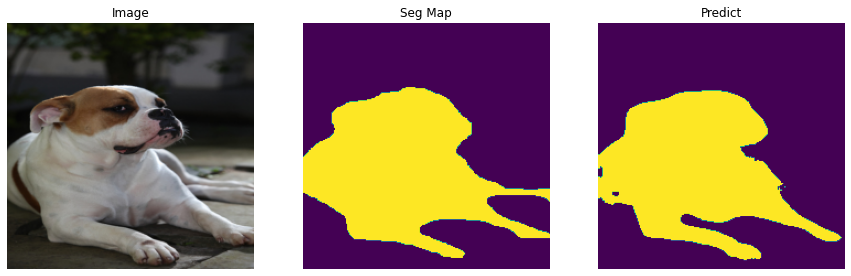

 Epoch: [29/30] - Validation
Validation step: Val Loss: 0.7140665650367737, Val Iou: 0.8246412873268127


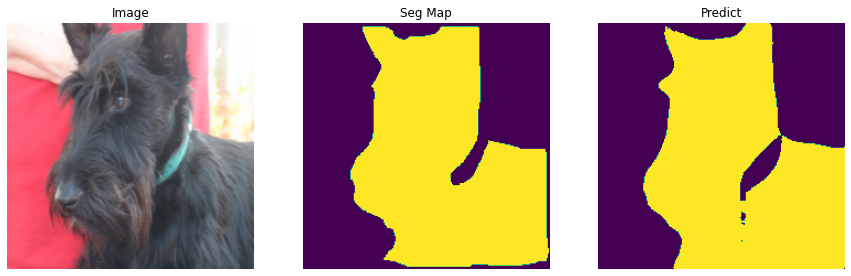

 Epoch: [30/30] - Train
Current Step: 50 	Train Loss: 0.5981964063644409, Train Iou: 0.9195594787597656


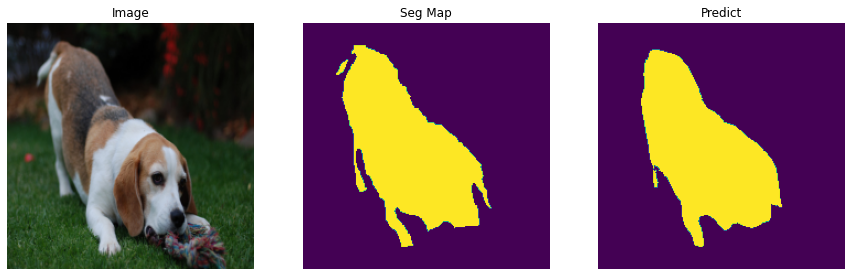

Current Step: 100 	Train Loss: 0.6032027971744537, Train Iou: 0.9171227812767029


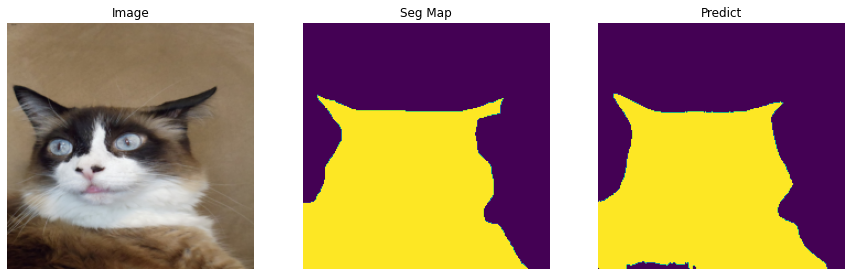

Current Step: 150 	Train Loss: 0.5961000919342041, Train Iou: 0.9187478423118591


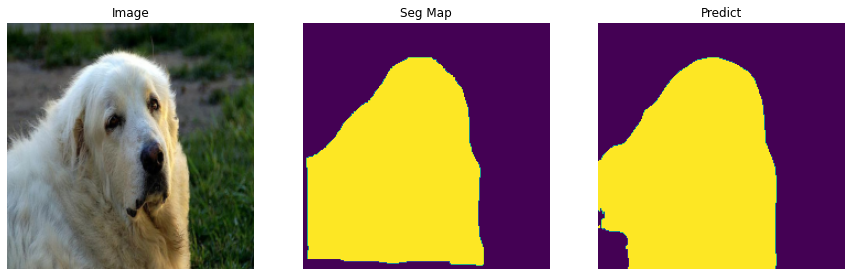

Current Step: 200 	Train Loss: 0.6064898204803467, Train Iou: 0.9140191674232483


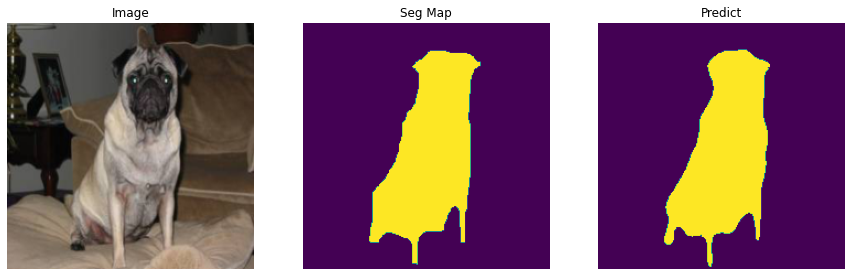

 Epoch: [30/30] - Validation
Validation step: Val Loss: 0.7123525738716125, Val Iou: 0.8181838393211365


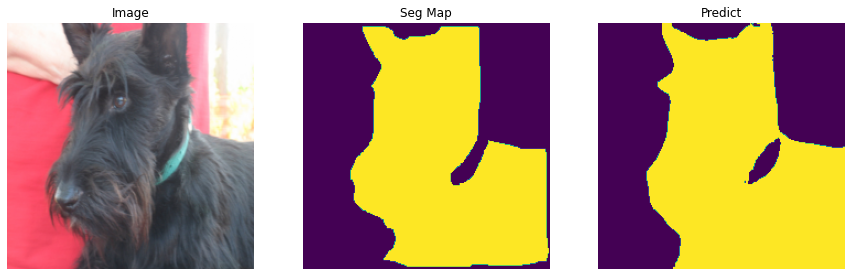

In [ ]:
train_result = []
val_result = []

for epoch in range(1, epochs + 1):
    train_loss, train_iou = train(epoch, model, train_loader, loss_fn, optimizer)
    val_loss, val_iou = validation(epoch, model, val_loader, loss_fn)
    
    train_result.append([train_loss, train_iou])
    val_result.append([val_loss, val_iou])

# Visualization Loss & IOU

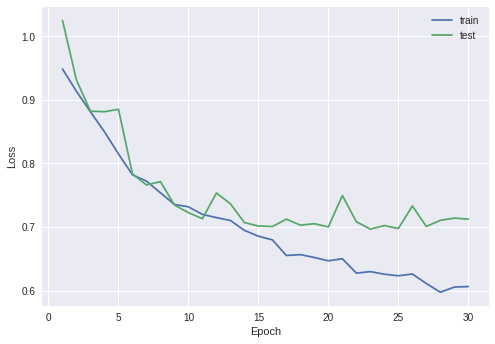

In [ ]:
plt.style.use('seaborn')
plt.plot([i for i in range(1, len(train_result) + 1)], [i[0] for i in train_result])
plt.plot([i for i in range(1, len(val_result) + 1)], [i[0] for i in val_result])
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend(["train", "test"])
plt.show()

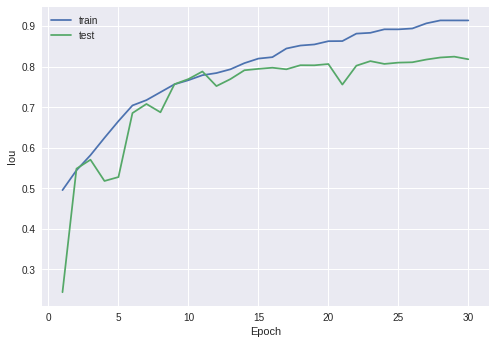

In [ ]:
plt.plot([i for i in range(1, len(train_result) + 1)], [i[1] for i in train_result])
plt.plot([i for i in range(1, len(val_result) + 1)], [i[1] for i in val_result])
plt.xlabel("Epoch")
plt.ylabel("Iou")
plt.legend(["train", "test"])
plt.show()

# Test Model & Save



Test Iou:  tensor(0.9458)


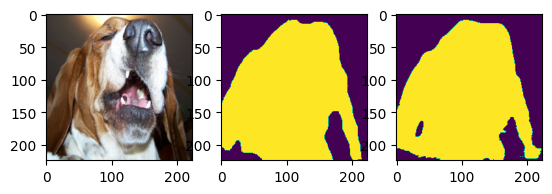

In [ ]:
image, seg = next(iter(val_loader))
img, seg_map = image[8], seg[8]

plt.style.use('default')
plt.subplot(131)
plt.imshow(torch.permute(img, (1, 2, 0)))
plt.subplot(132)
plt.imshow(torch.squeeze(seg_map, 0))

model.eval()
out = model(torch.unsqueeze(img, 0).to(device))
out = (out >= 0.5).int()
print('Test Iou: ', iou(out, seg_map))

out = torch.squeeze(out, 0)
out = torch.squeeze(out, 0)

plt.subplot(133)
plt.imshow(out.detach().cpu().numpy())
plt.show()

In [ ]:
PATH = '/content/drive/MyDrive/Models/'
torch.save(model, PATH + 'Segmentation_model.ckpt')